In [ ]:
# Import dependencies
from io import BytesIO
import base64
from PIL import Image

from bokeh import plotting, palettes
from bokeh.models import HoverTool, ColumnDataSource, CategoricalColorMapper
import numpy as np
import pandas as pd

plotting.output_notebook()

In [ ]:
# Woohoo! More dependencies
import matplotlib.colors as mplc
import matplotlib.pyplot as plt

In [ ]:
# Yet one more dependency
!pip install -q captum

from captum.attr import *

     |████████████████████████████████| 1.4 MB 13.5 MB/s 


In [ ]:
## This is a heavily modified helper function (originally taken from this source:
# https://tonio73.github.io/data-science/cnn/CnnVsDense-Part2-Visualization.html
# which also provided the code below that has been slightly modified, and
# https://tonio73.github.io/data-science/cnn/CnnVsDense-Part2-Visualization.html https://zapaishchykova.medium.com/the-meaningful-visualization-of-clusters-2a666be0f460)

## Bokeh seems to be able to render images but they have to be encoded in a certain format
## Captum has a visualization library that can overlay attribution data
## on top of the original data

# need original image AND the attribution data to pull this off
def embeddableImage(image_cluster, attribution_cluster):
    # data (an "image_cluster") should have the following dimensions: [4, 3, 130, 370]
    # as should the "attribution_cluster"
    encoded_subimages = []
    for sub_image, sub_attribution in zip(image_cluster, attribution_cluster):
      ### Commented code below can be ignored, was part of R&D...
      # need to normalize each image to be between 0.0 to 1.0
      # can assume that everything is already a numpy array
      #norm = mplc.Normalize(vmin = np.amin(sub_image), vmax = np.amax(sub_image))
      #img_data = (norm(sub_image) * 255).astype(np.uint8).transpose(1, 2, 0)
      #image = Image.fromarray(img_data, mode='RGB')
      print(sub_image.shape)
      fig, _ = visualization.visualize_image_attr(sub_attribution.transpose(1,2,0), sub_image.transpose(1,2,0), method="blended_heat_map", sign="absolute_value");
      buffer = BytesIO()
      #image.save(buffer, format='png')
      fig.savefig(buffer, format='png', bbox_inches='tight')
      encoded_subimages.append('data:image/png;base64,' + base64.b64encode(buffer.getvalue()).decode())
    return encoded_subimages

In [ ]:
import pandas as pd
import numpy as np

# x and attributions MUST have the same dimensions!
def umapPlot(embedding, x, y, attributions, yTrue=None, title=''):
    """ Plot the embedding of X and y with popovers using Bokeh """
    
    df = pd.DataFrame(embedding, columns=('x', 'y'))
    # for each image should be able to apply the embeddable image function
    # list of lists [rows x columns], x instances with 4 columns
    sub_images = np.array(list(map(embeddableImage, x, attributions)))
    for i in range(4):
      df['image'+str(i+1)] = sub_images[:,i]
    df['class'] = [str(d) for d in y]
    df['index'] = list(range(len(y)))
    if yTrue is not None:
        df['trueDigit'] = [str(d) for d in yTrue]

    datasource = ColumnDataSource(df)

    colorMapping = CategoricalColorMapper(factors=np.arange(10).astype(np.str), palette=palettes.Spectral10)

    plotFigure = plotting.figure(
        title=title,
        plot_width=600,
        plot_height=600,
        tools=('pan, wheel_zoom, reset')
    )

    if yTrue is None:
        tooltip = """
            <div>
                <div>
                    <img src='@image1' style='float: left; width:256px; height:50px; margin: 5px 5px 5px 5px'/>
                </div>
                <div>
                    <img src='@image2' style='float: left; width:256px; height:50px; margin: 5px 5px 5px 5px'/>
                </div>
                <div>
                    <img src='@image3' style='float: left; width:256px; height:50px; margin: 5px 5px 5px 5px'/>
                </div>
                <div>
                    <img src='@image4' style='float: left; width:256px; height:50px; margin: 5px 5px 5px 5px'/>
                </div>
                <div>
                    <span style='font-size: 16px; color: #224499'>Class:</span>
                    <span style='font-size: 18px'>@class</span>
                    <span style='font-size: 16px; color: #224499'>Index:</span>
                    <span style='font-size: 18px'>@index</span>
                </div>
            </div>
            """
    else:
        tooltip = """
            <div>
                <div>
                    <img src='@image' style='float: left; margin: 5px 5px 5px 5px'/>
                </div>
                <div>
                    <span style='font-size: 16px; color: #224499'>Digit:</span>
                    <span style='font-size: 18px'>@digit (true: @trueDigit)</span>
                </div>
            </div>
            """
    plotFigure.add_tools(HoverTool(tooltips=tooltip))

    plotFigure.circle(
        'x', 'y',
        source=datasource,
        color=dict(field='class', transform=colorMapping),
        line_alpha=0.6, fill_alpha=0.6, size=8
    )
    plotting.show(plotFigure)
    
    return plotFigure


In [ ]:
## Load the original data

import torch

from google.colab import drive
drive.mount('/content/drive')

# Get x and y
X_PATH = "/content/drive/Shareddrives/Exploding Gradients/x_train_b_cropped.npy"
Y_PATH= "/content/drive/Shareddrives/Exploding Gradients/y_train_b.npy"

x = np.load(X_PATH)
y = np.load(Y_PATH)

tensor_x = torch.Tensor(x) 
tensor_y = torch.Tensor(y).long()

tensor_x = torch.swapaxes(tensor_x,2,4)
tensor_x = torch.swapaxes(tensor_x,3,4)

Mounted at /content/drive


In [ ]:
del x,y

In [ ]:
# Get the attribution data
attribution_data = torch.load("drive/MyDrive/Fish Attribution/x_train_b_cropped_integrated_gradients.tensor")

In [ ]:
# UMAP install
!pip install -q umap-learn

import umap

     |████████████████████████████████| 86 kB 4.2 MB/s 
     |████████████████████████████████| 1.1 MB 55.6 MB/s 


In [ ]:
# the reducer is an instance of a UMAP object that will do the heavy lifting,
# giving us the x,y coordinates of interest from the original data
reducerFish = umap.UMAP(n_neighbors = 20,min_dist=0.5, verbose = True)
# There are 285 pieces of data, reshape the entire dataset such that it's just a series of flat tensors
# (4x3x130x750 = 1170000)
embeddingFish = reducerFish.fit_transform(torch.reshape(attribution_data, (285, 1170000)))

UMAP(min_dist=0.5, n_neighbors=20, verbose=True)


/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


Sat Apr  9 18:23:28 2022 Construct fuzzy simplicial set
Sat Apr  9 18:23:57 2022 Finding Nearest Neighbors
Sat Apr  9 18:24:00 2022 Finished Nearest Neighbor Search
Sat Apr  9 18:24:03 2022 Construct embedding


Epochs completed:   0%|            0/500 [00:00]

Sat Apr  9 18:24:08 2022 Finished embedding


In [ ]:
type(embeddingFish) # sanity check

numpy.ndarray

(3, 130, 750)


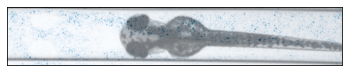

(3, 130, 750)


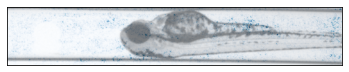

(3, 130, 750)


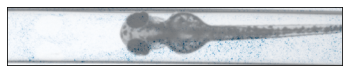

(3, 130, 750)


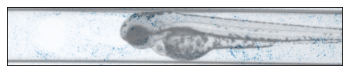

(3, 130, 750)


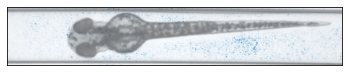

(3, 130, 750)


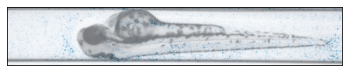

(3, 130, 750)


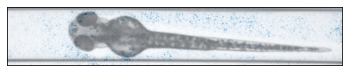

(3, 130, 750)


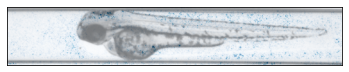

(3, 130, 750)


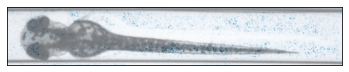

(3, 130, 750)


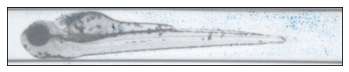

(3, 130, 750)


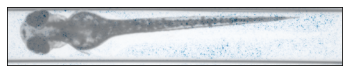

(3, 130, 750)


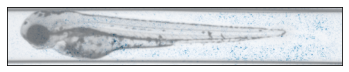

(3, 130, 750)


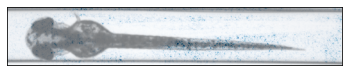

(3, 130, 750)


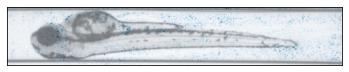

(3, 130, 750)


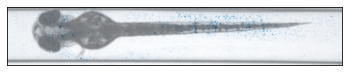

(3, 130, 750)


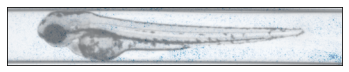

(3, 130, 750)


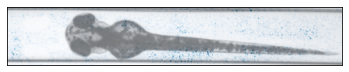

(3, 130, 750)


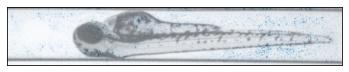

(3, 130, 750)


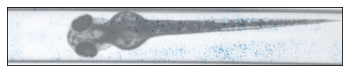

(3, 130, 750)


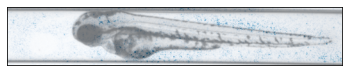

(3, 130, 750)


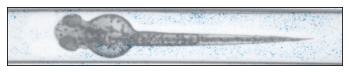

(3, 130, 750)


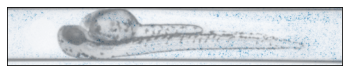

(3, 130, 750)


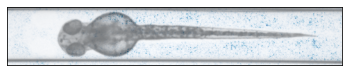

(3, 130, 750)


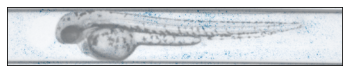

(3, 130, 750)


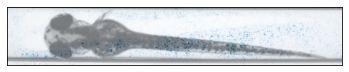

(3, 130, 750)


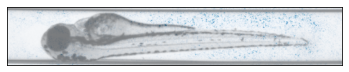

(3, 130, 750)


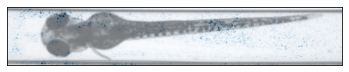

(3, 130, 750)


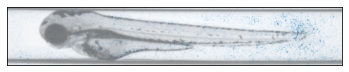

(3, 130, 750)


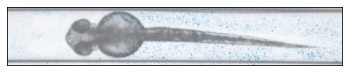

(3, 130, 750)


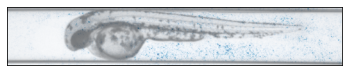

(3, 130, 750)


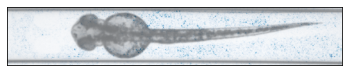

(3, 130, 750)


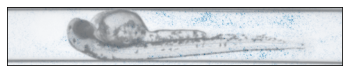

(3, 130, 750)


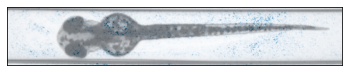

(3, 130, 750)


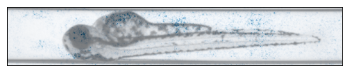

(3, 130, 750)


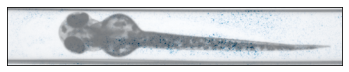

(3, 130, 750)


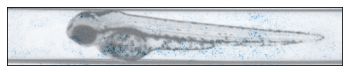

(3, 130, 750)


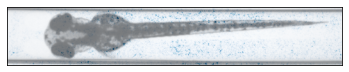

(3, 130, 750)


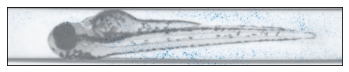

(3, 130, 750)


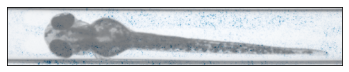

(3, 130, 750)


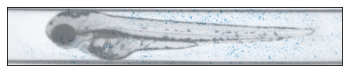

(3, 130, 750)


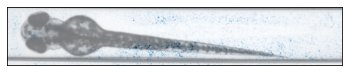

(3, 130, 750)


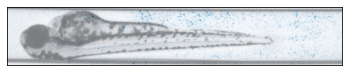

(3, 130, 750)


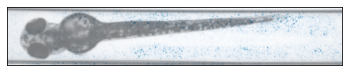

(3, 130, 750)


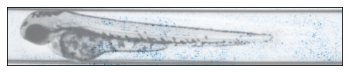

(3, 130, 750)


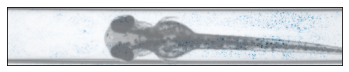

(3, 130, 750)


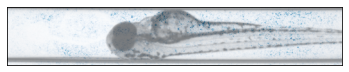

(3, 130, 750)


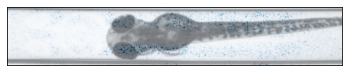

(3, 130, 750)


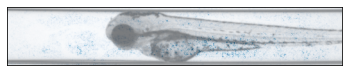

(3, 130, 750)


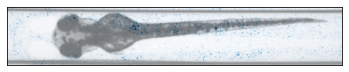

(3, 130, 750)


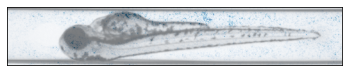

(3, 130, 750)


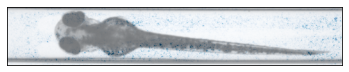

(3, 130, 750)


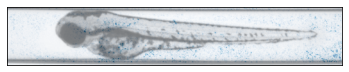

(3, 130, 750)


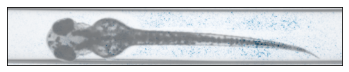

(3, 130, 750)


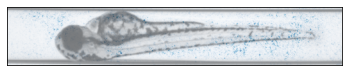

(3, 130, 750)


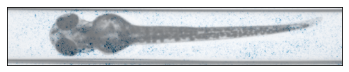

(3, 130, 750)


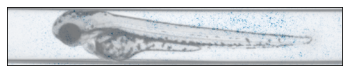

(3, 130, 750)


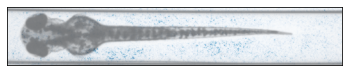

(3, 130, 750)


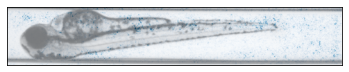

(3, 130, 750)


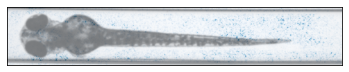

(3, 130, 750)


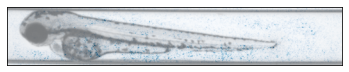

(3, 130, 750)


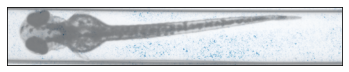

(3, 130, 750)


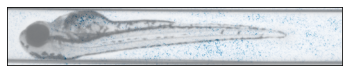

(3, 130, 750)


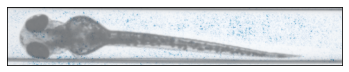

(3, 130, 750)


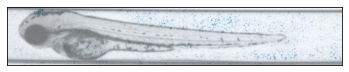

(3, 130, 750)


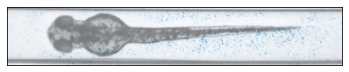

(3, 130, 750)


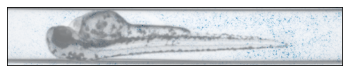

(3, 130, 750)


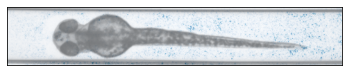

(3, 130, 750)


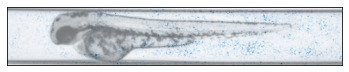

(3, 130, 750)


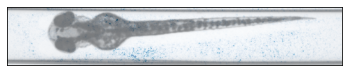

(3, 130, 750)


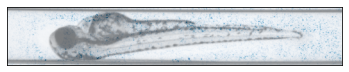

(3, 130, 750)


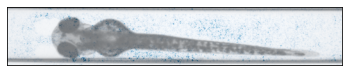

(3, 130, 750)


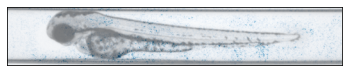

(3, 130, 750)


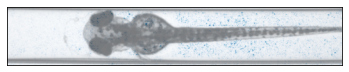

(3, 130, 750)


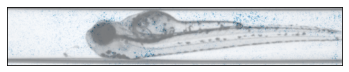

(3, 130, 750)


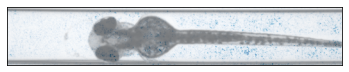

(3, 130, 750)


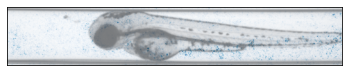

(3, 130, 750)


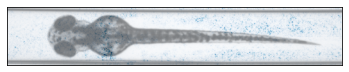

(3, 130, 750)


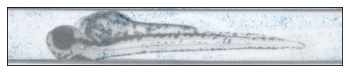

(3, 130, 750)


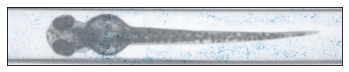

(3, 130, 750)


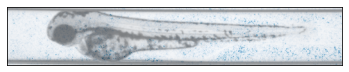

(3, 130, 750)


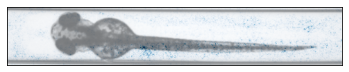

(3, 130, 750)


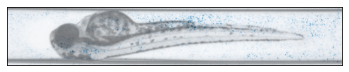

(3, 130, 750)


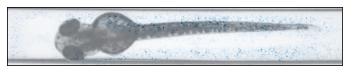

(3, 130, 750)


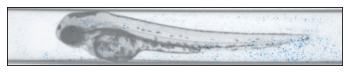

(3, 130, 750)


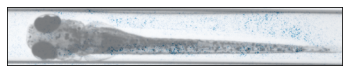

(3, 130, 750)


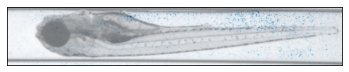

(3, 130, 750)


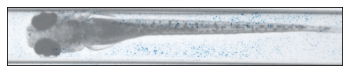

(3, 130, 750)


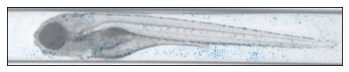

(3, 130, 750)


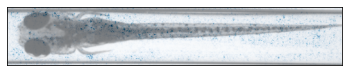

(3, 130, 750)


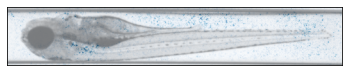

(3, 130, 750)


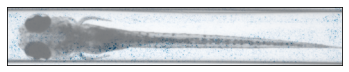

(3, 130, 750)


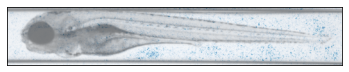

(3, 130, 750)


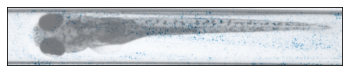

(3, 130, 750)


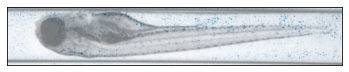

(3, 130, 750)


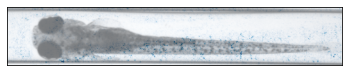

(3, 130, 750)


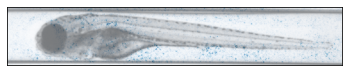

(3, 130, 750)


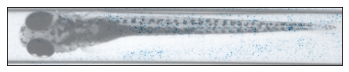

(3, 130, 750)


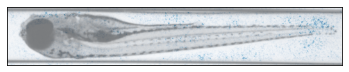

(3, 130, 750)


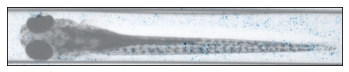

(3, 130, 750)


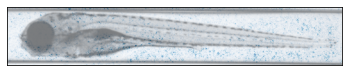

(3, 130, 750)


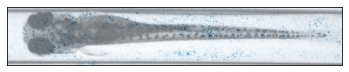

(3, 130, 750)


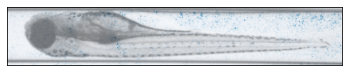

(3, 130, 750)


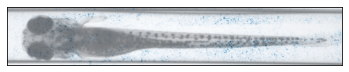

(3, 130, 750)


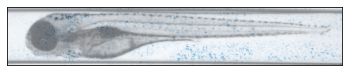

(3, 130, 750)


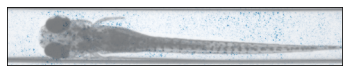

(3, 130, 750)


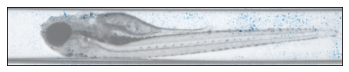

(3, 130, 750)


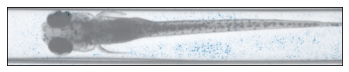

(3, 130, 750)


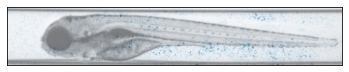

(3, 130, 750)


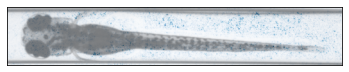

(3, 130, 750)


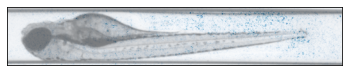

(3, 130, 750)


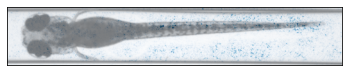

(3, 130, 750)


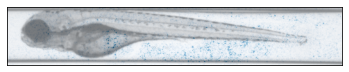

(3, 130, 750)


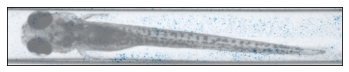

(3, 130, 750)


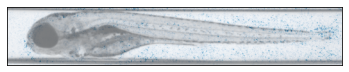

(3, 130, 750)


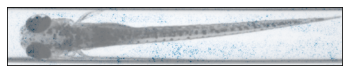

(3, 130, 750)


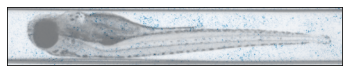

(3, 130, 750)


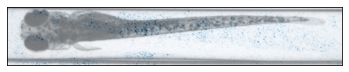

(3, 130, 750)


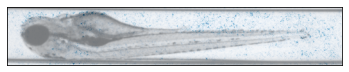

(3, 130, 750)


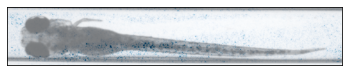

(3, 130, 750)


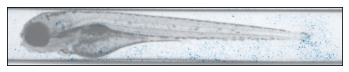

(3, 130, 750)


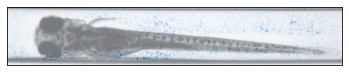

(3, 130, 750)


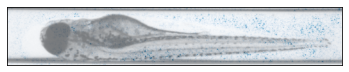

(3, 130, 750)


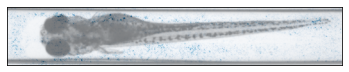

(3, 130, 750)


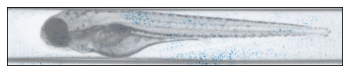

(3, 130, 750)


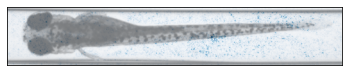

(3, 130, 750)


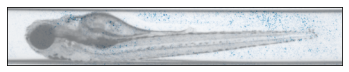

(3, 130, 750)


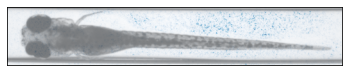

(3, 130, 750)


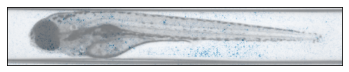

(3, 130, 750)


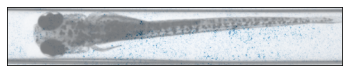

(3, 130, 750)


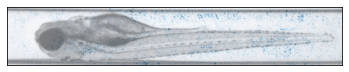

(3, 130, 750)


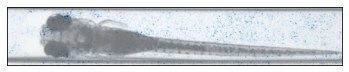

(3, 130, 750)


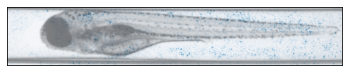

(3, 130, 750)


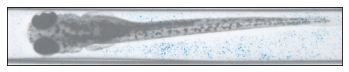

(3, 130, 750)


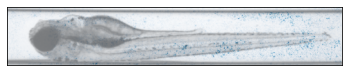

(3, 130, 750)


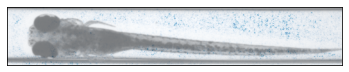

(3, 130, 750)


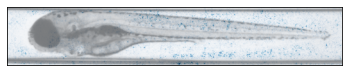

(3, 130, 750)


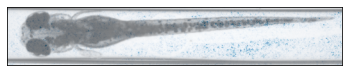

(3, 130, 750)


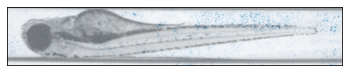

(3, 130, 750)


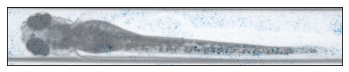

(3, 130, 750)


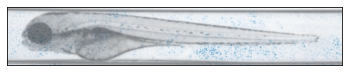

(3, 130, 750)


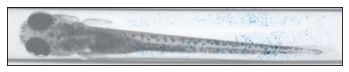

(3, 130, 750)


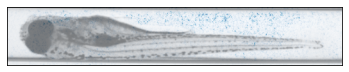

(3, 130, 750)


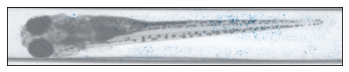

(3, 130, 750)


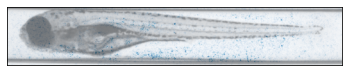

(3, 130, 750)


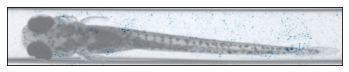

(3, 130, 750)


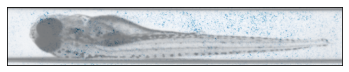

(3, 130, 750)


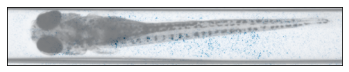

(3, 130, 750)


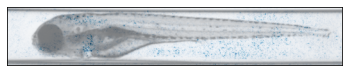

(3, 130, 750)


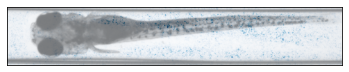

(3, 130, 750)


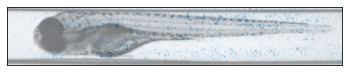

(3, 130, 750)


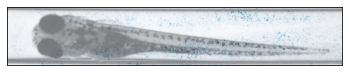

(3, 130, 750)


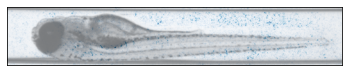

(3, 130, 750)


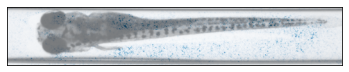

(3, 130, 750)


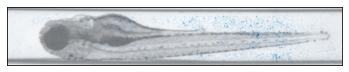

(3, 130, 750)


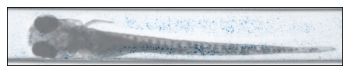

(3, 130, 750)


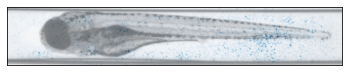

(3, 130, 750)


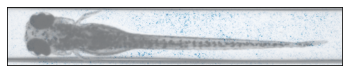

(3, 130, 750)


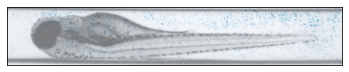

(3, 130, 750)


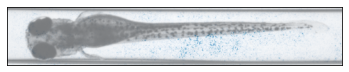

(3, 130, 750)


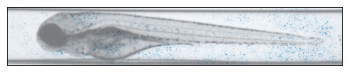

(3, 130, 750)


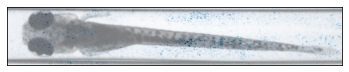

(3, 130, 750)


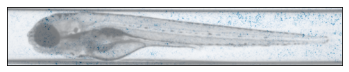

(3, 130, 750)


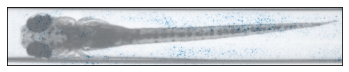

(3, 130, 750)


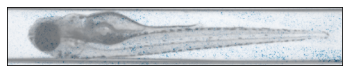

(3, 130, 750)


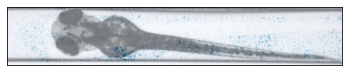

(3, 130, 750)


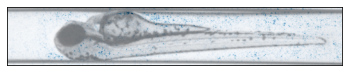

(3, 130, 750)


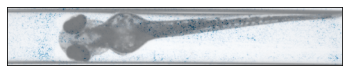

(3, 130, 750)


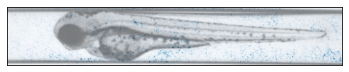

(3, 130, 750)


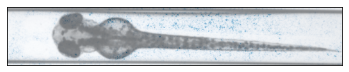

(3, 130, 750)


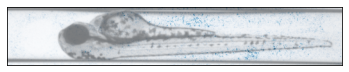

(3, 130, 750)


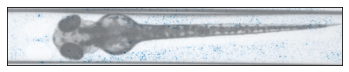

(3, 130, 750)


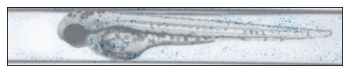

(3, 130, 750)


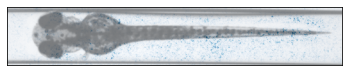

(3, 130, 750)


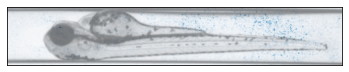

(3, 130, 750)


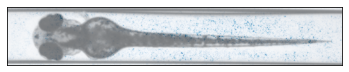

(3, 130, 750)


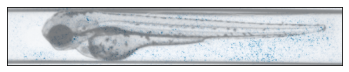

(3, 130, 750)


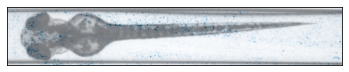

(3, 130, 750)


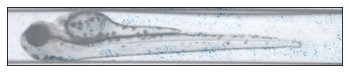

(3, 130, 750)


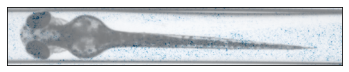

(3, 130, 750)


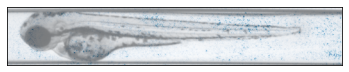

(3, 130, 750)


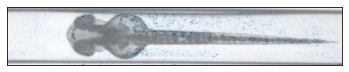

(3, 130, 750)


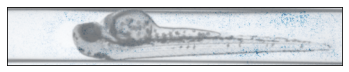

(3, 130, 750)


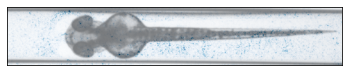

(3, 130, 750)


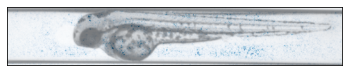

(3, 130, 750)


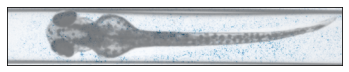

(3, 130, 750)


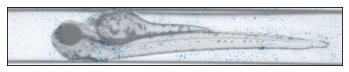

(3, 130, 750)


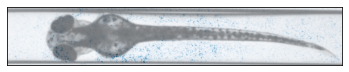

(3, 130, 750)


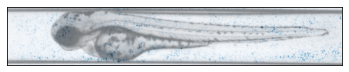

(3, 130, 750)


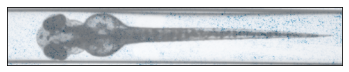

(3, 130, 750)


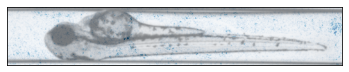

(3, 130, 750)


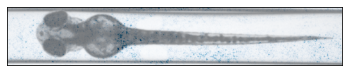

(3, 130, 750)


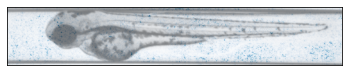

(3, 130, 750)


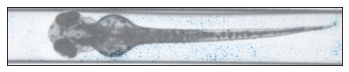

(3, 130, 750)


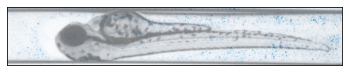

(3, 130, 750)


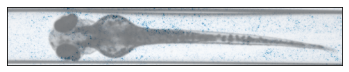

(3, 130, 750)


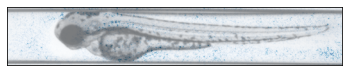

(3, 130, 750)


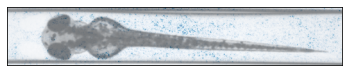

(3, 130, 750)


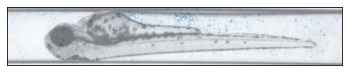

(3, 130, 750)


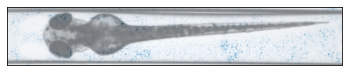

(3, 130, 750)


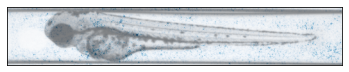

(3, 130, 750)


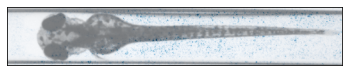

(3, 130, 750)


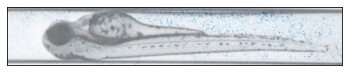

(3, 130, 750)


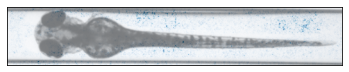

(3, 130, 750)


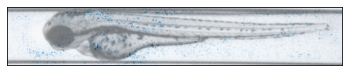

(3, 130, 750)


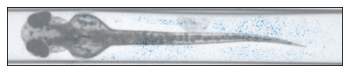

(3, 130, 750)


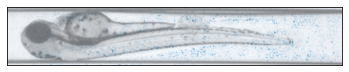

(3, 130, 750)


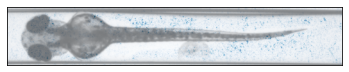

(3, 130, 750)


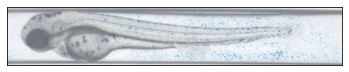

(3, 130, 750)


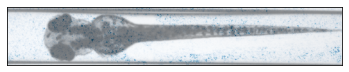

(3, 130, 750)


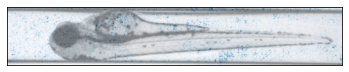

(3, 130, 750)


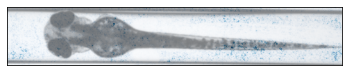

(3, 130, 750)


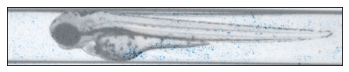

(3, 130, 750)


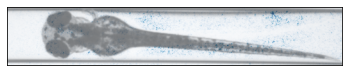

(3, 130, 750)


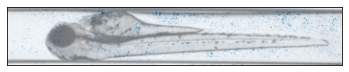

(3, 130, 750)


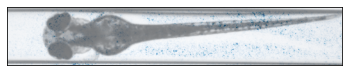

(3, 130, 750)


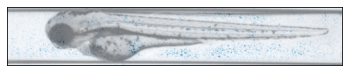

(3, 130, 750)


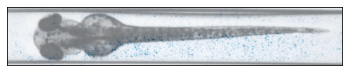

(3, 130, 750)


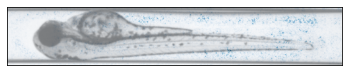

(3, 130, 750)


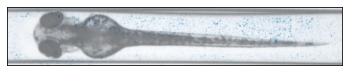

(3, 130, 750)


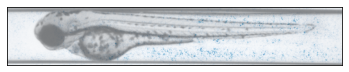

(3, 130, 750)


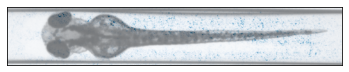

(3, 130, 750)


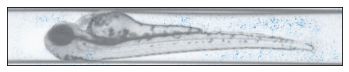

(3, 130, 750)


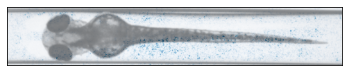

(3, 130, 750)


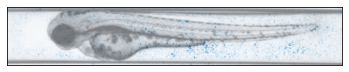

(3, 130, 750)


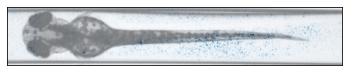

(3, 130, 750)


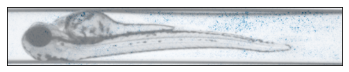

(3, 130, 750)


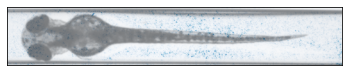

(3, 130, 750)


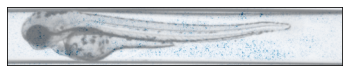

(3, 130, 750)


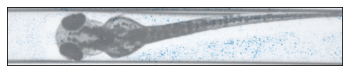

(3, 130, 750)


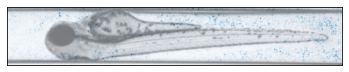

(3, 130, 750)


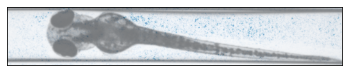

(3, 130, 750)


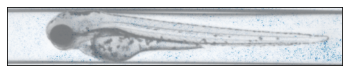

(3, 130, 750)


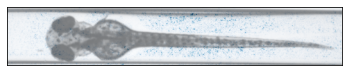

(3, 130, 750)


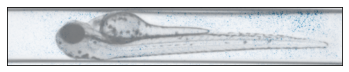

(3, 130, 750)


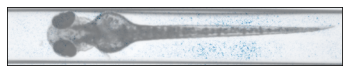

(3, 130, 750)


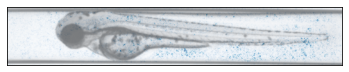

(3, 130, 750)


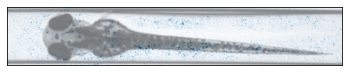

(3, 130, 750)


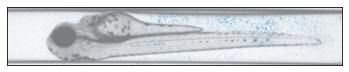

(3, 130, 750)


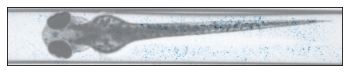

(3, 130, 750)


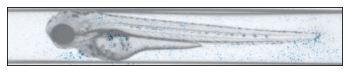

(3, 130, 750)


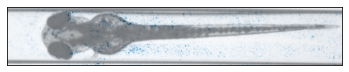

(3, 130, 750)


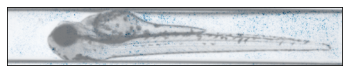

(3, 130, 750)


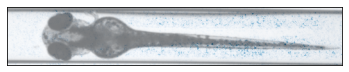

(3, 130, 750)


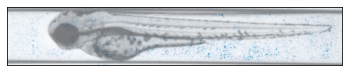

(3, 130, 750)


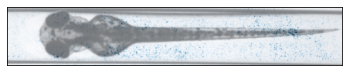

(3, 130, 750)


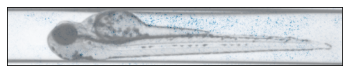

(3, 130, 750)


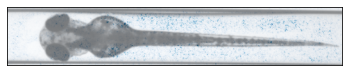

(3, 130, 750)


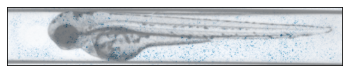

(3, 130, 750)


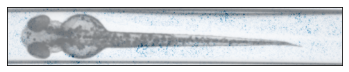

(3, 130, 750)


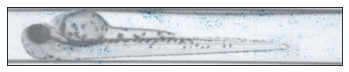

(3, 130, 750)


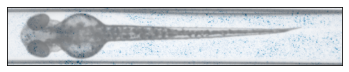

(3, 130, 750)


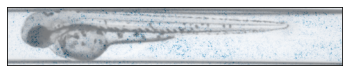

(3, 130, 750)


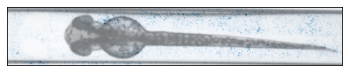

(3, 130, 750)


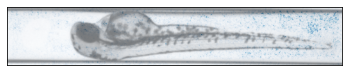

(3, 130, 750)


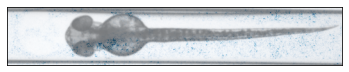

(3, 130, 750)


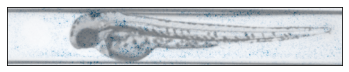

(3, 130, 750)


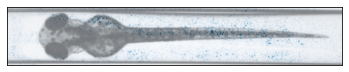

(3, 130, 750)


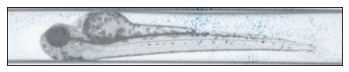

(3, 130, 750)


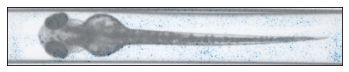

(3, 130, 750)


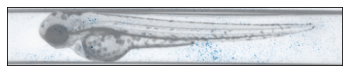

(3, 130, 750)


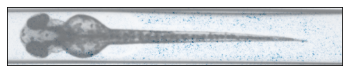

(3, 130, 750)


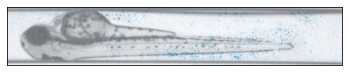

(3, 130, 750)


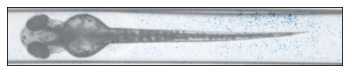

(3, 130, 750)


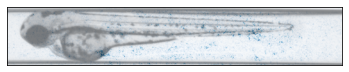

(3, 130, 750)


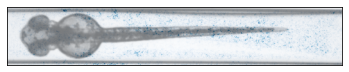

(3, 130, 750)


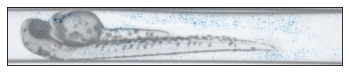

(3, 130, 750)


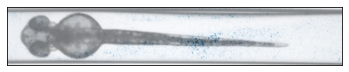

(3, 130, 750)


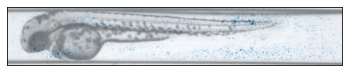

(3, 130, 750)


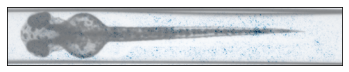

(3, 130, 750)


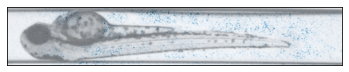

(3, 130, 750)


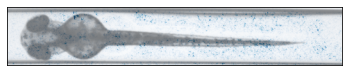

(3, 130, 750)


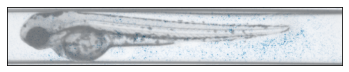

(3, 130, 750)


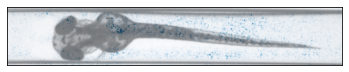

(3, 130, 750)


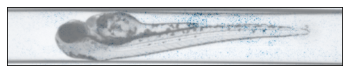

(3, 130, 750)


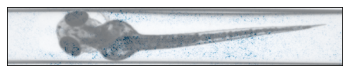

(3, 130, 750)


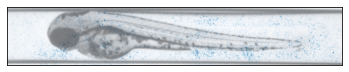

(3, 130, 750)


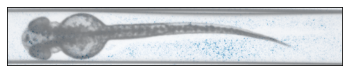

(3, 130, 750)


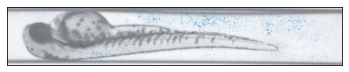

(3, 130, 750)


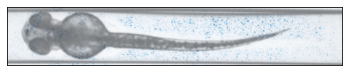

(3, 130, 750)


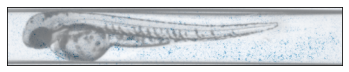

(3, 130, 750)


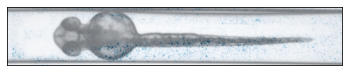

(3, 130, 750)


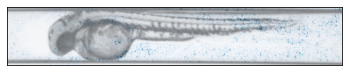

(3, 130, 750)


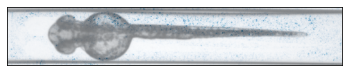

(3, 130, 750)


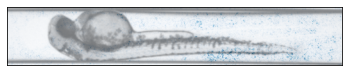

(3, 130, 750)


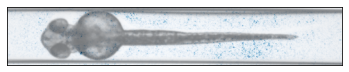

(3, 130, 750)


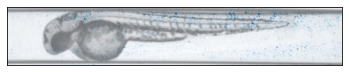

(3, 130, 750)


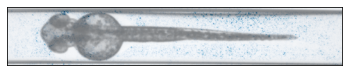

(3, 130, 750)


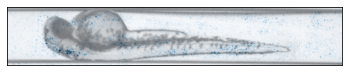

(3, 130, 750)


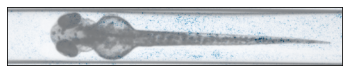

(3, 130, 750)


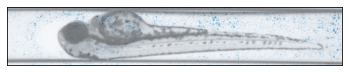

(3, 130, 750)


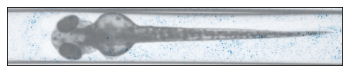

(3, 130, 750)


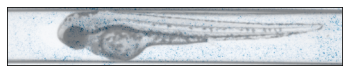

(3, 130, 750)


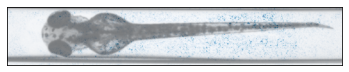

(3, 130, 750)


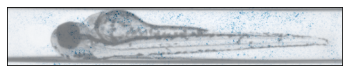

(3, 130, 750)


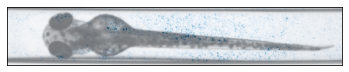

(3, 130, 750)


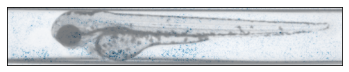

(3, 130, 750)


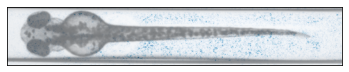

(3, 130, 750)


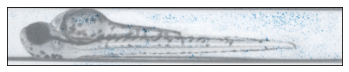

(3, 130, 750)


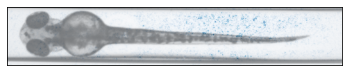

(3, 130, 750)


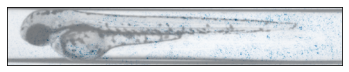

(3, 130, 750)


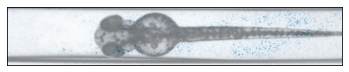

(3, 130, 750)


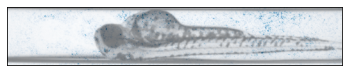

(3, 130, 750)


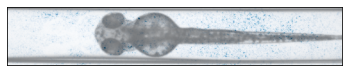

(3, 130, 750)


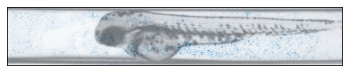

(3, 130, 750)


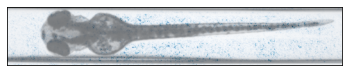

(3, 130, 750)


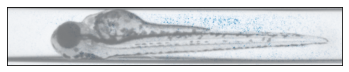

(3, 130, 750)


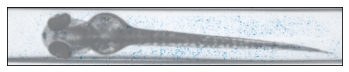

(3, 130, 750)


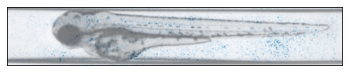

(3, 130, 750)


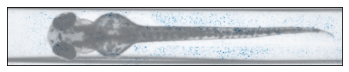

(3, 130, 750)


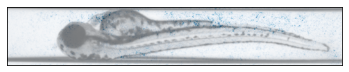

(3, 130, 750)


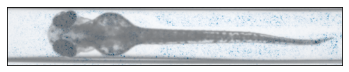

(3, 130, 750)


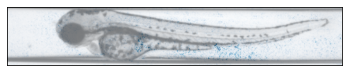

(3, 130, 750)


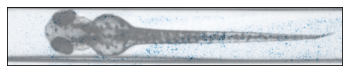

(3, 130, 750)


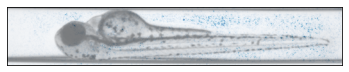

(3, 130, 750)


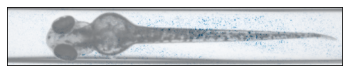

(3, 130, 750)


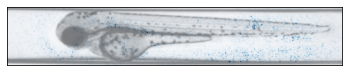

(3, 130, 750)


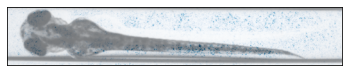

(3, 130, 750)


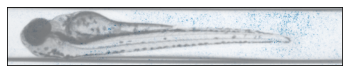

(3, 130, 750)


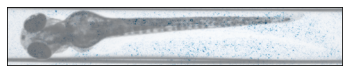

(3, 130, 750)


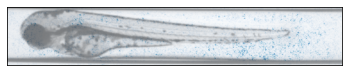

(3, 130, 750)


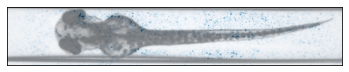

(3, 130, 750)


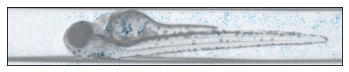

(3, 130, 750)


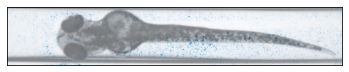

(3, 130, 750)


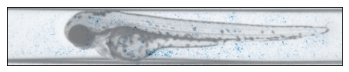

(3, 130, 750)


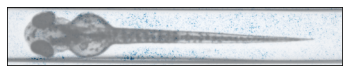

(3, 130, 750)


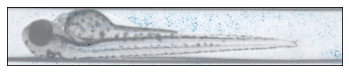

(3, 130, 750)


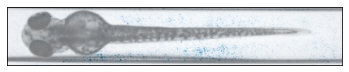

(3, 130, 750)


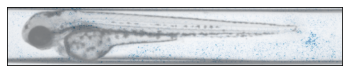

(3, 130, 750)


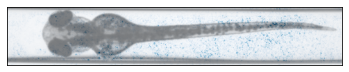

(3, 130, 750)


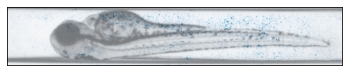

(3, 130, 750)


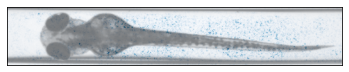

(3, 130, 750)


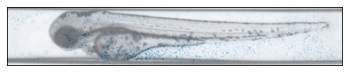

(3, 130, 750)


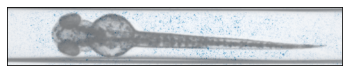

(3, 130, 750)


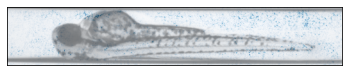

(3, 130, 750)


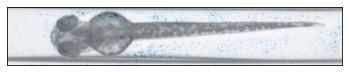

(3, 130, 750)


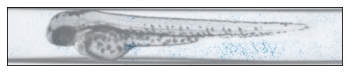

(3, 130, 750)


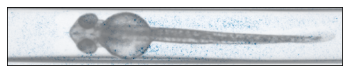

(3, 130, 750)


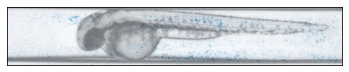

(3, 130, 750)


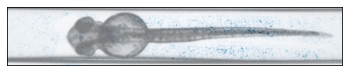

(3, 130, 750)


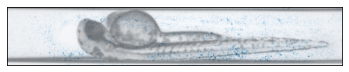

(3, 130, 750)


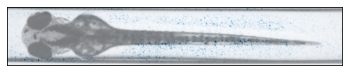

(3, 130, 750)


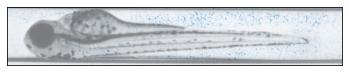

(3, 130, 750)


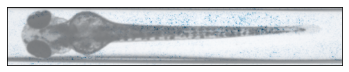

(3, 130, 750)


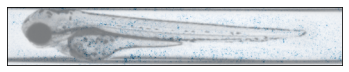

(3, 130, 750)


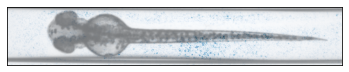

(3, 130, 750)


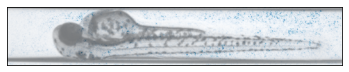

(3, 130, 750)


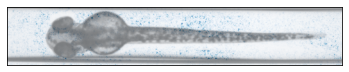

(3, 130, 750)


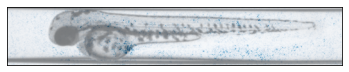

(3, 130, 750)


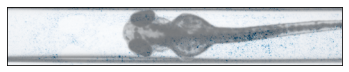

(3, 130, 750)


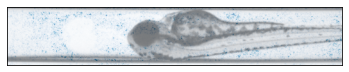

(3, 130, 750)


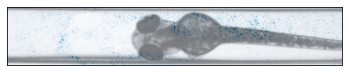

(3, 130, 750)


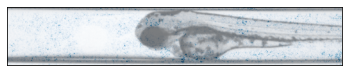

(3, 130, 750)


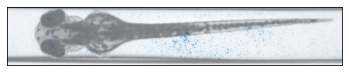

(3, 130, 750)


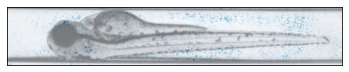

(3, 130, 750)


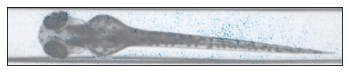

(3, 130, 750)


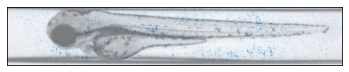

(3, 130, 750)


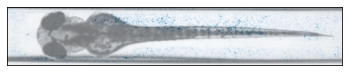

(3, 130, 750)


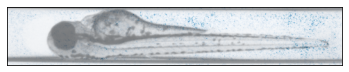

(3, 130, 750)


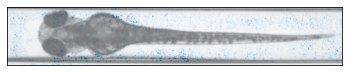

(3, 130, 750)


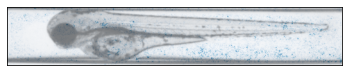

(3, 130, 750)


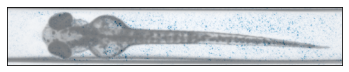

(3, 130, 750)


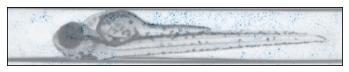

(3, 130, 750)


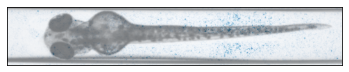

(3, 130, 750)


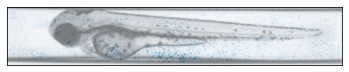

(3, 130, 750)


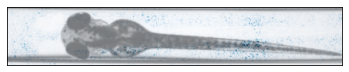

(3, 130, 750)


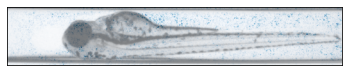

(3, 130, 750)


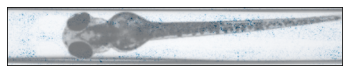

(3, 130, 750)


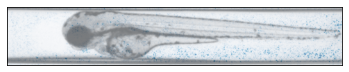

(3, 130, 750)


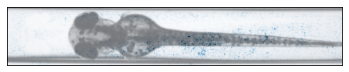

(3, 130, 750)


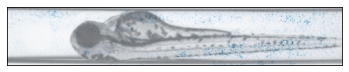

(3, 130, 750)


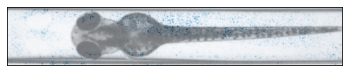

(3, 130, 750)


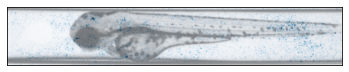

(3, 130, 750)


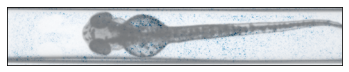

(3, 130, 750)


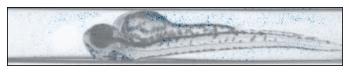

(3, 130, 750)


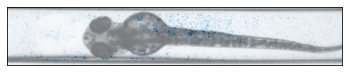

(3, 130, 750)


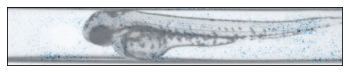

(3, 130, 750)


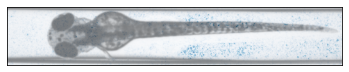

(3, 130, 750)


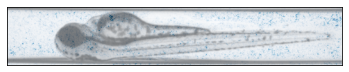

(3, 130, 750)


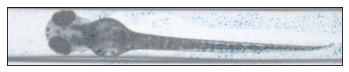

(3, 130, 750)


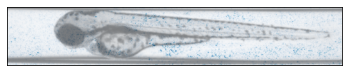

(3, 130, 750)


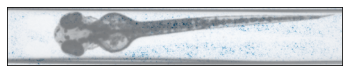

(3, 130, 750)


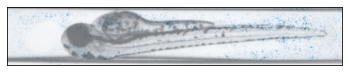

(3, 130, 750)


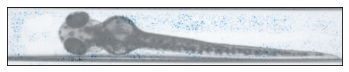

(3, 130, 750)


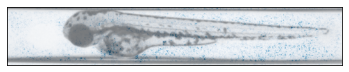

(3, 130, 750)


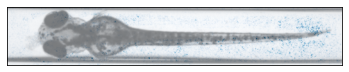

(3, 130, 750)


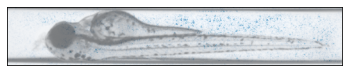

(3, 130, 750)


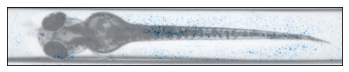

(3, 130, 750)


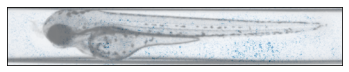

(3, 130, 750)


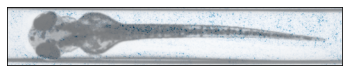

(3, 130, 750)


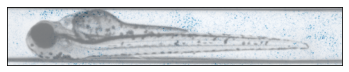

(3, 130, 750)


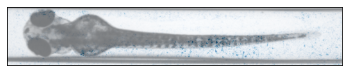

(3, 130, 750)


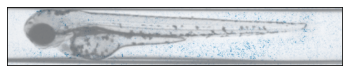

(3, 130, 750)


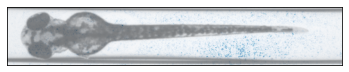

(3, 130, 750)


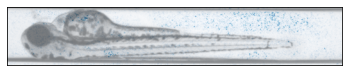

(3, 130, 750)


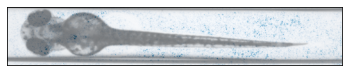

(3, 130, 750)


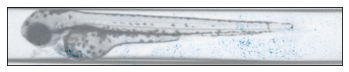

(3, 130, 750)


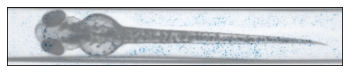

(3, 130, 750)


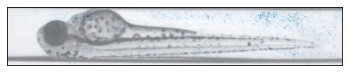

(3, 130, 750)


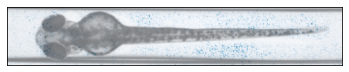

(3, 130, 750)


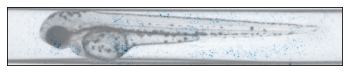

(3, 130, 750)


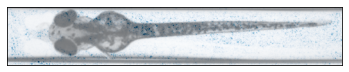

(3, 130, 750)


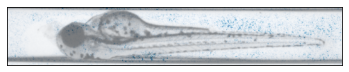

(3, 130, 750)


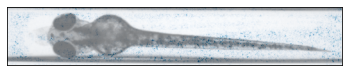

(3, 130, 750)


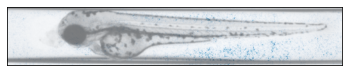

(3, 130, 750)


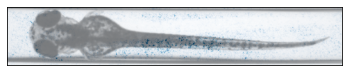

(3, 130, 750)


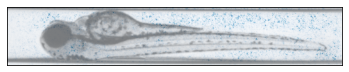

(3, 130, 750)


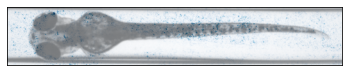

(3, 130, 750)


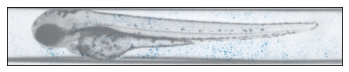

(3, 130, 750)


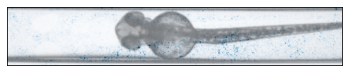

(3, 130, 750)


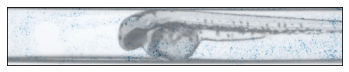

(3, 130, 750)


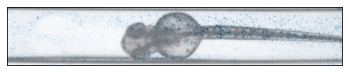

(3, 130, 750)


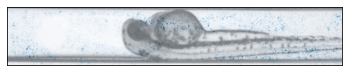

(3, 130, 750)


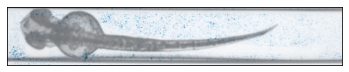

(3, 130, 750)


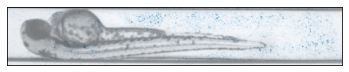

(3, 130, 750)


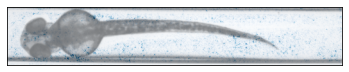

(3, 130, 750)


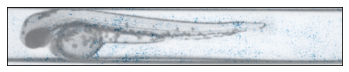

(3, 130, 750)


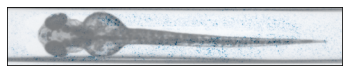

(3, 130, 750)


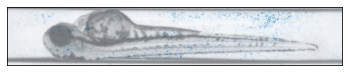

(3, 130, 750)


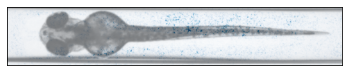

(3, 130, 750)


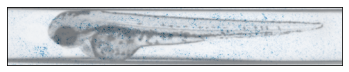

(3, 130, 750)


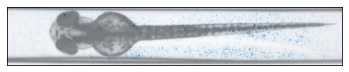

(3, 130, 750)


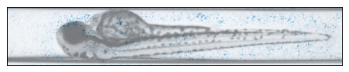

(3, 130, 750)


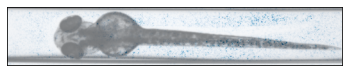

(3, 130, 750)


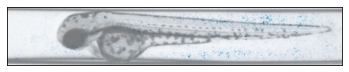

(3, 130, 750)


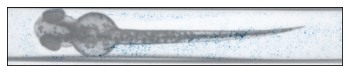

(3, 130, 750)


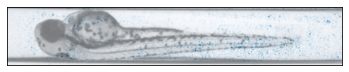

(3, 130, 750)


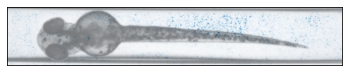

(3, 130, 750)


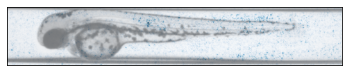

(3, 130, 750)


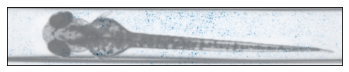

(3, 130, 750)


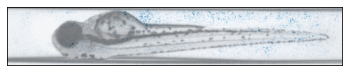

(3, 130, 750)


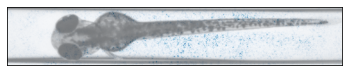

(3, 130, 750)


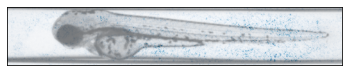

(3, 130, 750)


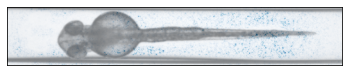

(3, 130, 750)


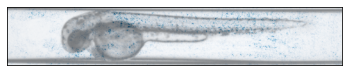

(3, 130, 750)


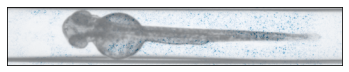

(3, 130, 750)


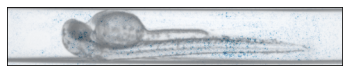

(3, 130, 750)


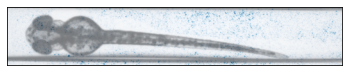

(3, 130, 750)


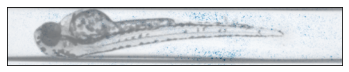

(3, 130, 750)


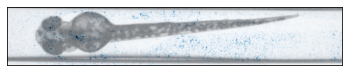

(3, 130, 750)


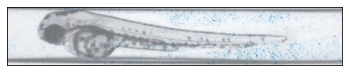

(3, 130, 750)


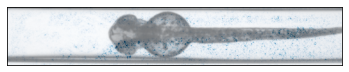

(3, 130, 750)


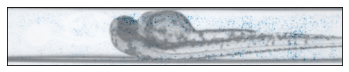

(3, 130, 750)


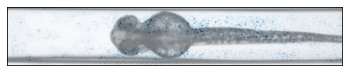

(3, 130, 750)


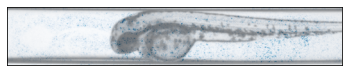

(3, 130, 750)


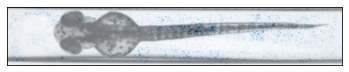

(3, 130, 750)


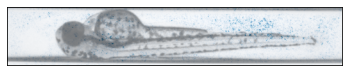

(3, 130, 750)


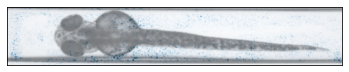

(3, 130, 750)


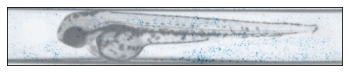

(3, 130, 750)


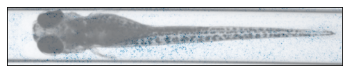

(3, 130, 750)


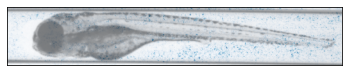

(3, 130, 750)


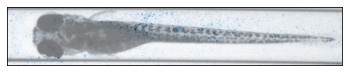

(3, 130, 750)


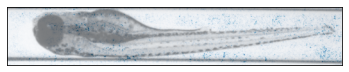

(3, 130, 750)


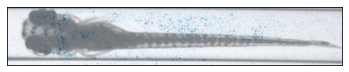

(3, 130, 750)


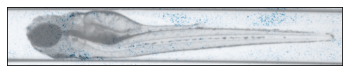

(3, 130, 750)


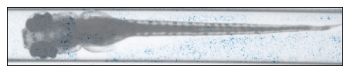

(3, 130, 750)


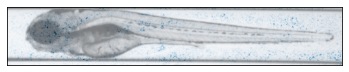

(3, 130, 750)


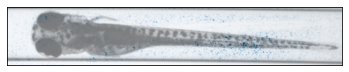

(3, 130, 750)


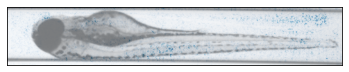

(3, 130, 750)


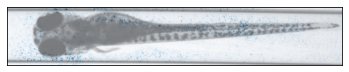

(3, 130, 750)


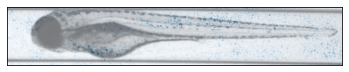

(3, 130, 750)


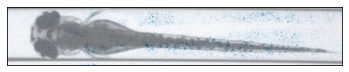

(3, 130, 750)


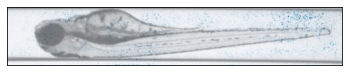

(3, 130, 750)


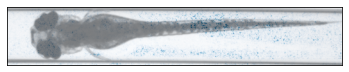

(3, 130, 750)


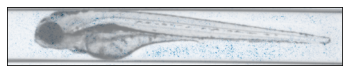

(3, 130, 750)


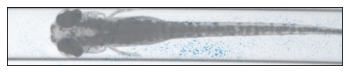

(3, 130, 750)


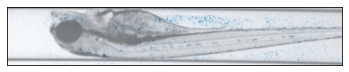

(3, 130, 750)


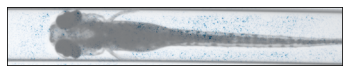

(3, 130, 750)


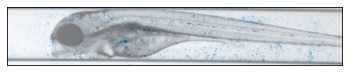

(3, 130, 750)


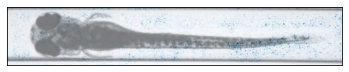

(3, 130, 750)


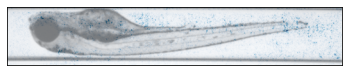

(3, 130, 750)


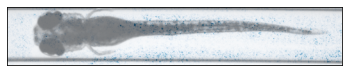

(3, 130, 750)


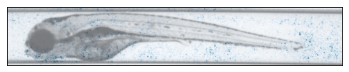

(3, 130, 750)


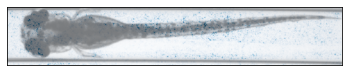

(3, 130, 750)


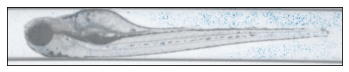

(3, 130, 750)


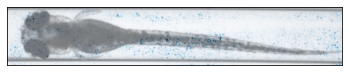

(3, 130, 750)


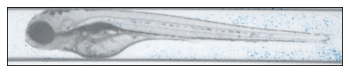

(3, 130, 750)


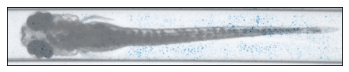

(3, 130, 750)


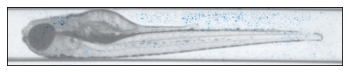

(3, 130, 750)


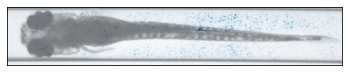

(3, 130, 750)


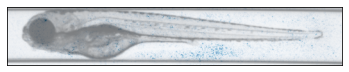

(3, 130, 750)


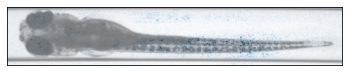

(3, 130, 750)


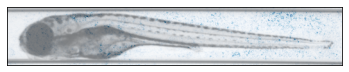

(3, 130, 750)


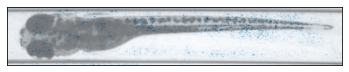

(3, 130, 750)


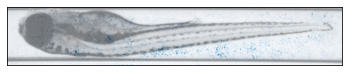

(3, 130, 750)


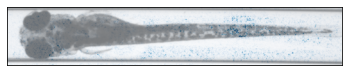

(3, 130, 750)


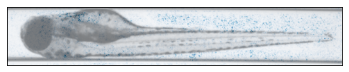

(3, 130, 750)


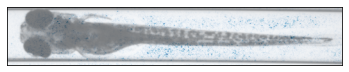

(3, 130, 750)


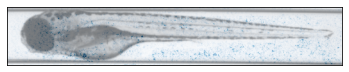

(3, 130, 750)


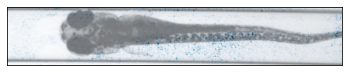

(3, 130, 750)


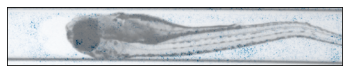

(3, 130, 750)


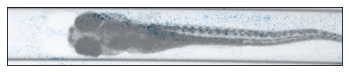

(3, 130, 750)


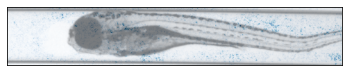

(3, 130, 750)


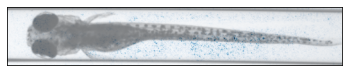

(3, 130, 750)


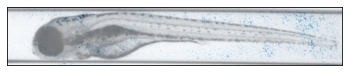

(3, 130, 750)


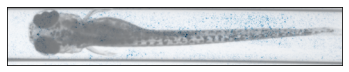

(3, 130, 750)


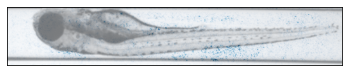

(3, 130, 750)


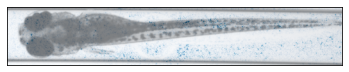

(3, 130, 750)


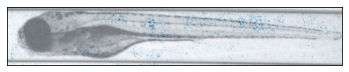

(3, 130, 750)


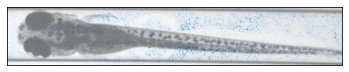

(3, 130, 750)


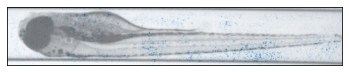

(3, 130, 750)


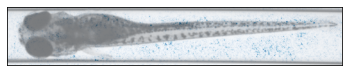

(3, 130, 750)


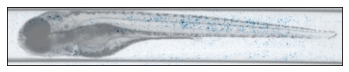

(3, 130, 750)


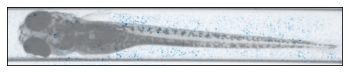

(3, 130, 750)


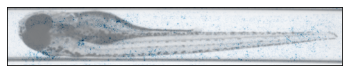

(3, 130, 750)


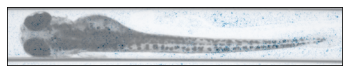

(3, 130, 750)


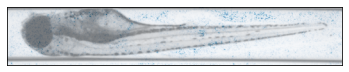

(3, 130, 750)


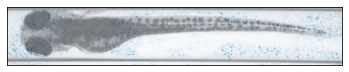

(3, 130, 750)


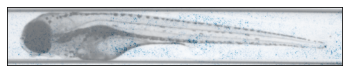

(3, 130, 750)


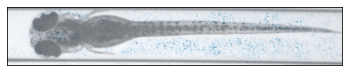

(3, 130, 750)


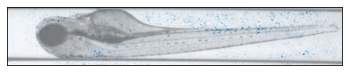

(3, 130, 750)


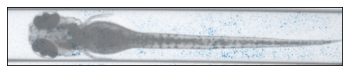

(3, 130, 750)


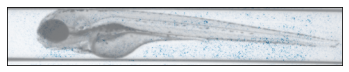

(3, 130, 750)


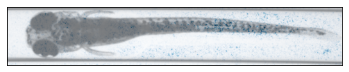

(3, 130, 750)


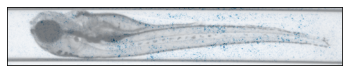

(3, 130, 750)


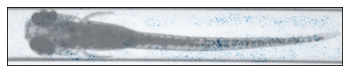

(3, 130, 750)


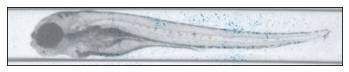

(3, 130, 750)


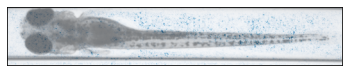

(3, 130, 750)


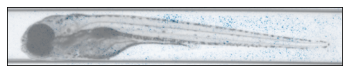

(3, 130, 750)


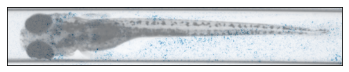

(3, 130, 750)


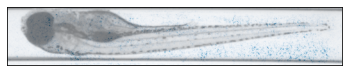

(3, 130, 750)


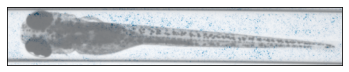

(3, 130, 750)


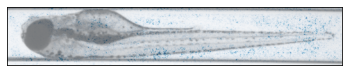

(3, 130, 750)


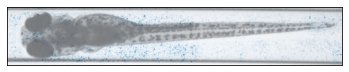

(3, 130, 750)


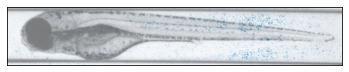

(3, 130, 750)


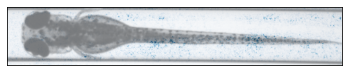

(3, 130, 750)


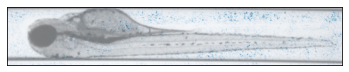

(3, 130, 750)


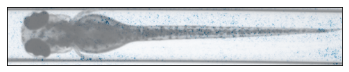

(3, 130, 750)


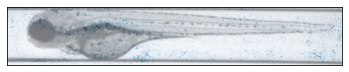

(3, 130, 750)


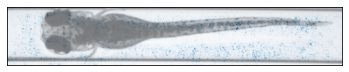

(3, 130, 750)


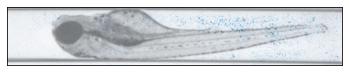

(3, 130, 750)


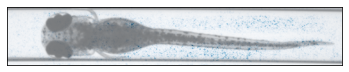

(3, 130, 750)


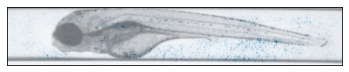

(3, 130, 750)


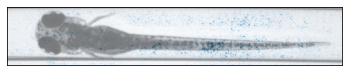

(3, 130, 750)


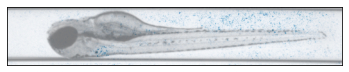

(3, 130, 750)


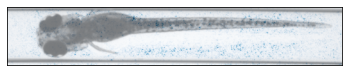

(3, 130, 750)


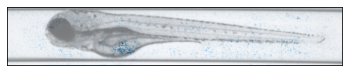

(3, 130, 750)


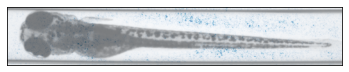

(3, 130, 750)


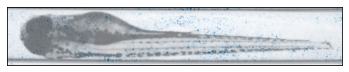

(3, 130, 750)


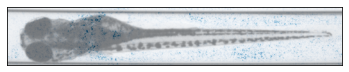

(3, 130, 750)


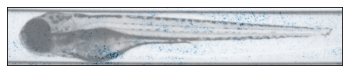

(3, 130, 750)


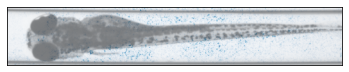

(3, 130, 750)


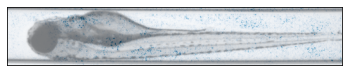

(3, 130, 750)


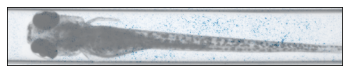

(3, 130, 750)


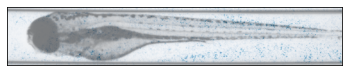

(3, 130, 750)


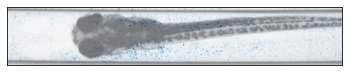

(3, 130, 750)


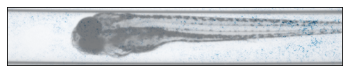

(3, 130, 750)


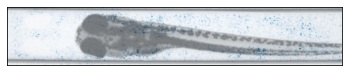

(3, 130, 750)


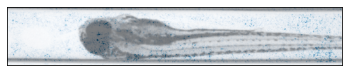

(3, 130, 750)


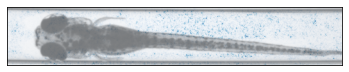

(3, 130, 750)


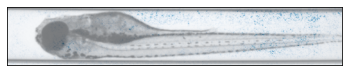

(3, 130, 750)


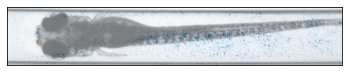

(3, 130, 750)


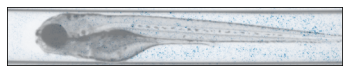

(3, 130, 750)


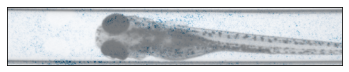

(3, 130, 750)


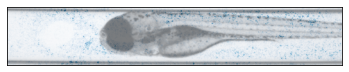

(3, 130, 750)


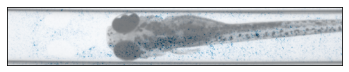

(3, 130, 750)


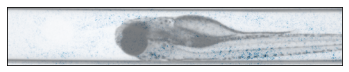

(3, 130, 750)


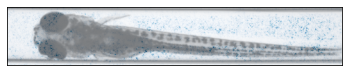

(3, 130, 750)


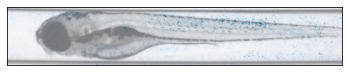

(3, 130, 750)


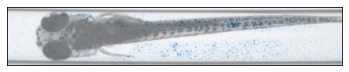

(3, 130, 750)


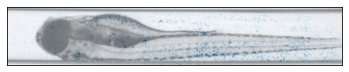

(3, 130, 750)


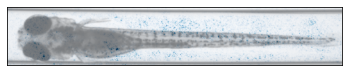

(3, 130, 750)


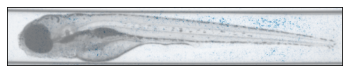

(3, 130, 750)


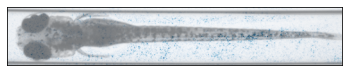

(3, 130, 750)


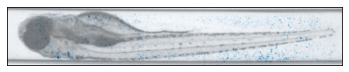

(3, 130, 750)


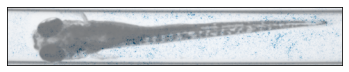

(3, 130, 750)


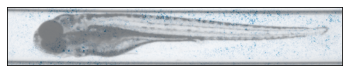

(3, 130, 750)


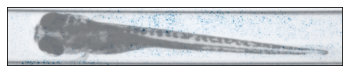

(3, 130, 750)


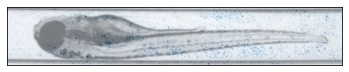

(3, 130, 750)


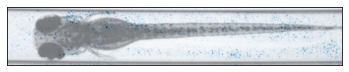

(3, 130, 750)


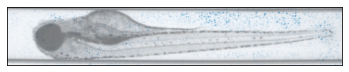

(3, 130, 750)


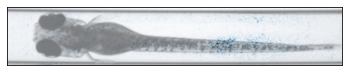

(3, 130, 750)


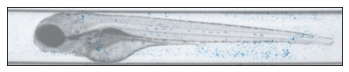

(3, 130, 750)


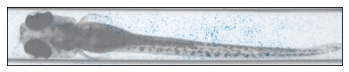

(3, 130, 750)


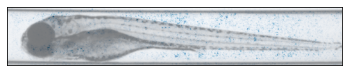

(3, 130, 750)


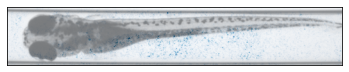

(3, 130, 750)


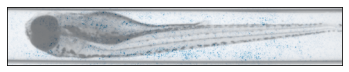

(3, 130, 750)


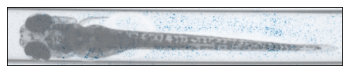

(3, 130, 750)


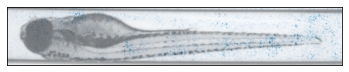

(3, 130, 750)


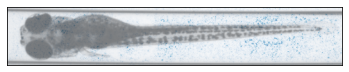

(3, 130, 750)


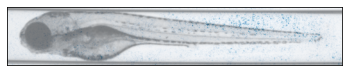

(3, 130, 750)


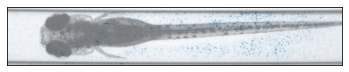

(3, 130, 750)


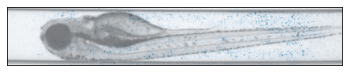

(3, 130, 750)


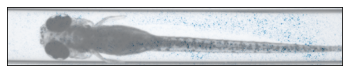

(3, 130, 750)


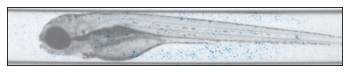

(3, 130, 750)


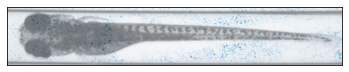

(3, 130, 750)


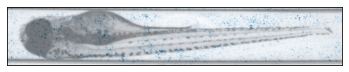

(3, 130, 750)


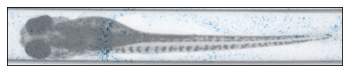

(3, 130, 750)


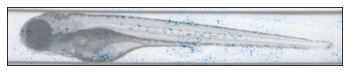

(3, 130, 750)


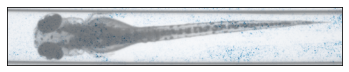

(3, 130, 750)


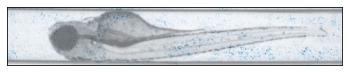

(3, 130, 750)


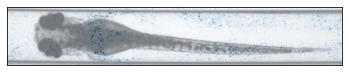

(3, 130, 750)


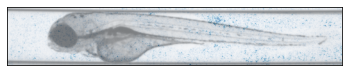

(3, 130, 750)


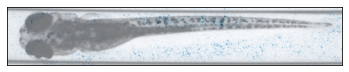

(3, 130, 750)


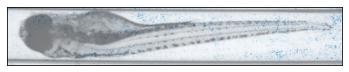

(3, 130, 750)


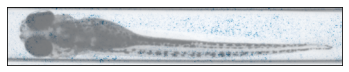

(3, 130, 750)


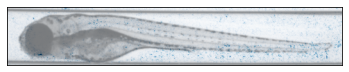

(3, 130, 750)


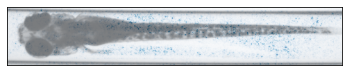

(3, 130, 750)


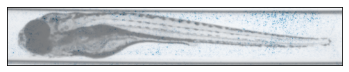

(3, 130, 750)


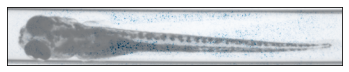

(3, 130, 750)


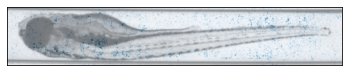

(3, 130, 750)


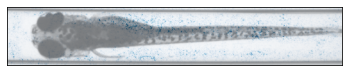

(3, 130, 750)


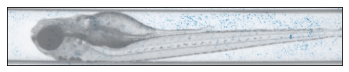

(3, 130, 750)


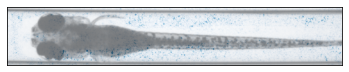

(3, 130, 750)


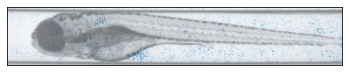

(3, 130, 750)


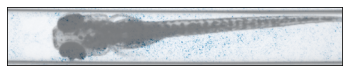

(3, 130, 750)


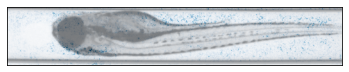

(3, 130, 750)


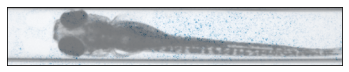

(3, 130, 750)


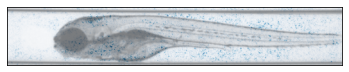

(3, 130, 750)


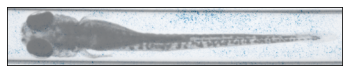

(3, 130, 750)


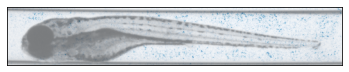

(3, 130, 750)


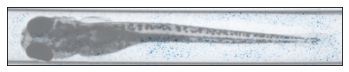

(3, 130, 750)


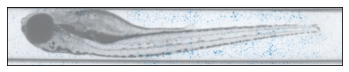

(3, 130, 750)


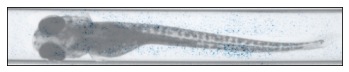

(3, 130, 750)


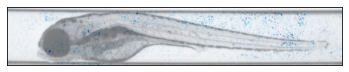

(3, 130, 750)


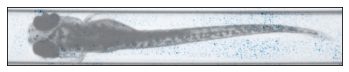

(3, 130, 750)


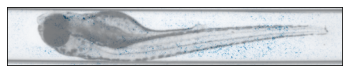

(3, 130, 750)


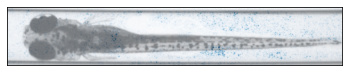

(3, 130, 750)


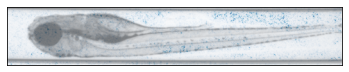

(3, 130, 750)


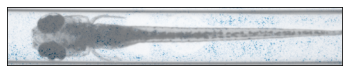

(3, 130, 750)


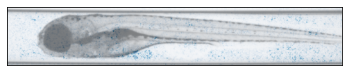

(3, 130, 750)


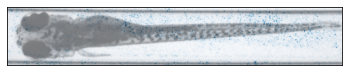

(3, 130, 750)


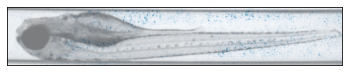

(3, 130, 750)


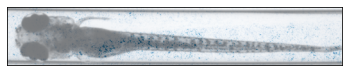

(3, 130, 750)


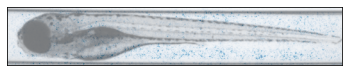

(3, 130, 750)


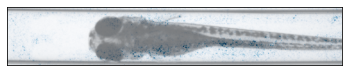

(3, 130, 750)


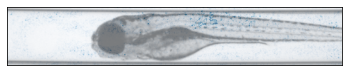

(3, 130, 750)


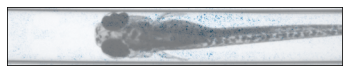

(3, 130, 750)


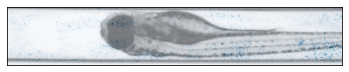

(3, 130, 750)


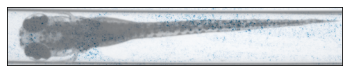

(3, 130, 750)


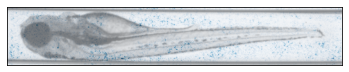

(3, 130, 750)


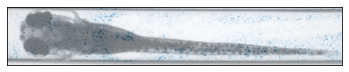

(3, 130, 750)


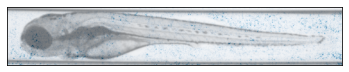

(3, 130, 750)


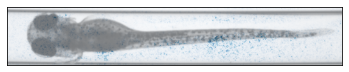

(3, 130, 750)


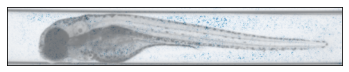

(3, 130, 750)


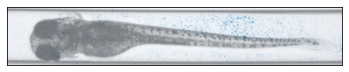

(3, 130, 750)


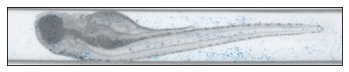

(3, 130, 750)


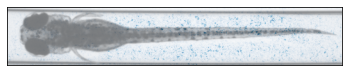

(3, 130, 750)


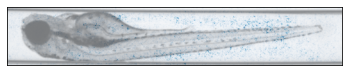

(3, 130, 750)


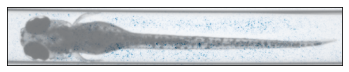

(3, 130, 750)


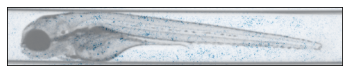

(3, 130, 750)


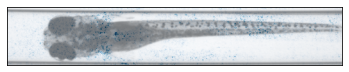

(3, 130, 750)


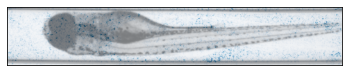

(3, 130, 750)


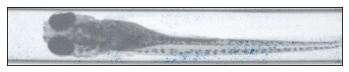

(3, 130, 750)


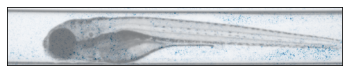

(3, 130, 750)


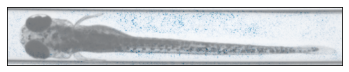

(3, 130, 750)


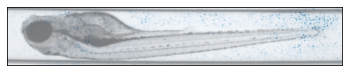

(3, 130, 750)


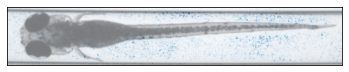

(3, 130, 750)


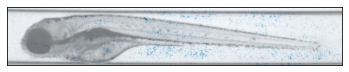

(3, 130, 750)


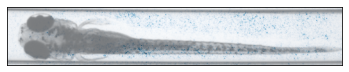

(3, 130, 750)


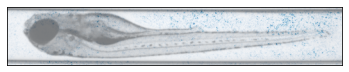

(3, 130, 750)


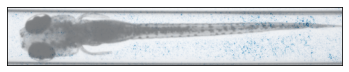

(3, 130, 750)


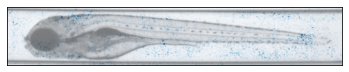

(3, 130, 750)


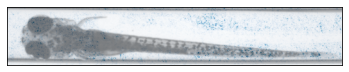

(3, 130, 750)


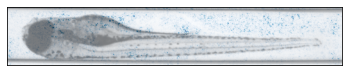

(3, 130, 750)


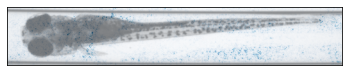

(3, 130, 750)


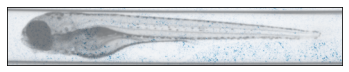

(3, 130, 750)


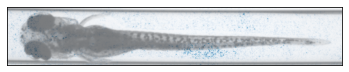

(3, 130, 750)


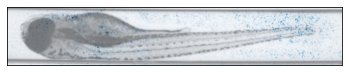

(3, 130, 750)


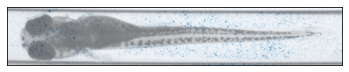

(3, 130, 750)


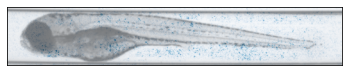

(3, 130, 750)


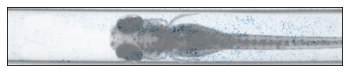

(3, 130, 750)


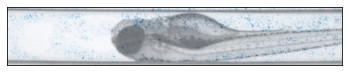

(3, 130, 750)


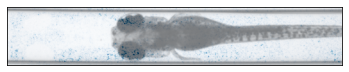

(3, 130, 750)


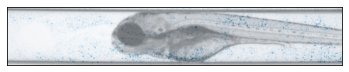

(3, 130, 750)


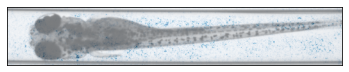

(3, 130, 750)


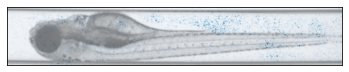

(3, 130, 750)


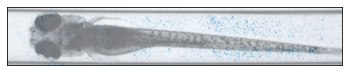

(3, 130, 750)


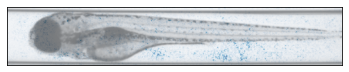

(3, 130, 750)


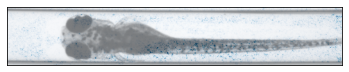

(3, 130, 750)


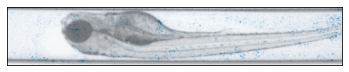

(3, 130, 750)


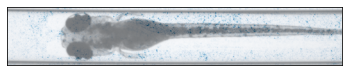

(3, 130, 750)


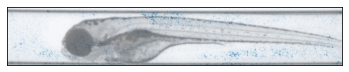

(3, 130, 750)


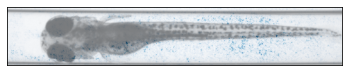

(3, 130, 750)


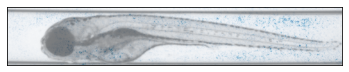

(3, 130, 750)


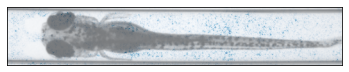

(3, 130, 750)


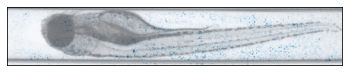

(3, 130, 750)


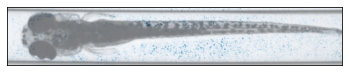

(3, 130, 750)


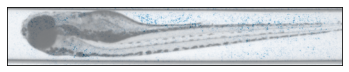

(3, 130, 750)


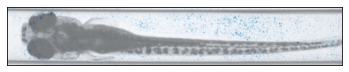

(3, 130, 750)


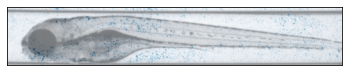

(3, 130, 750)


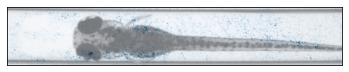

(3, 130, 750)


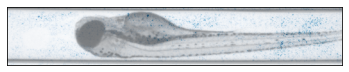

(3, 130, 750)


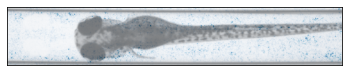

(3, 130, 750)


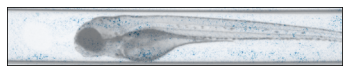

(3, 130, 750)


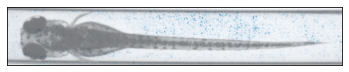

(3, 130, 750)


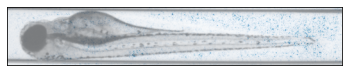

(3, 130, 750)


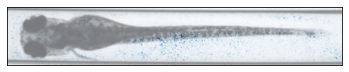

(3, 130, 750)


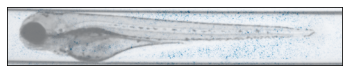

(3, 130, 750)


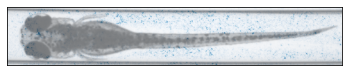

(3, 130, 750)


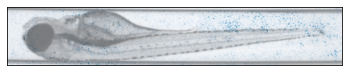

(3, 130, 750)


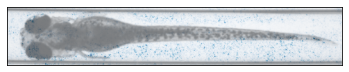

(3, 130, 750)


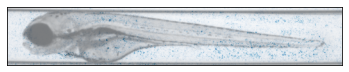

(3, 130, 750)


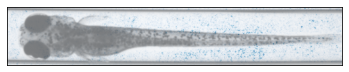

(3, 130, 750)


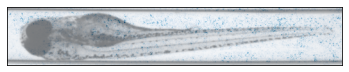

(3, 130, 750)


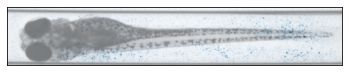

(3, 130, 750)


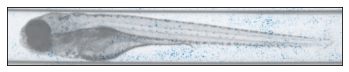

(3, 130, 750)


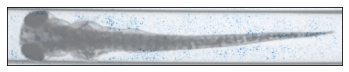

(3, 130, 750)


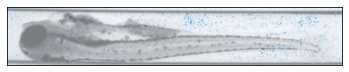

(3, 130, 750)


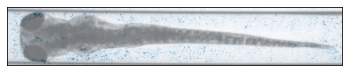

(3, 130, 750)


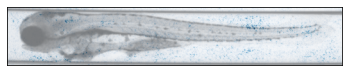

(3, 130, 750)


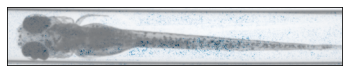

(3, 130, 750)


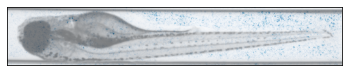

(3, 130, 750)


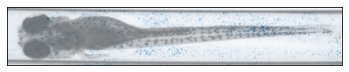

(3, 130, 750)


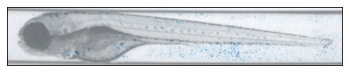

(3, 130, 750)


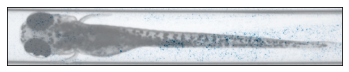

(3, 130, 750)


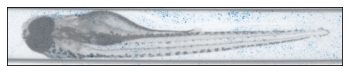

(3, 130, 750)


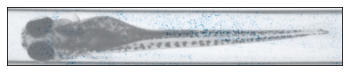

(3, 130, 750)


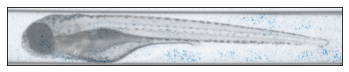

(3, 130, 750)


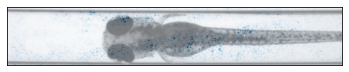

(3, 130, 750)


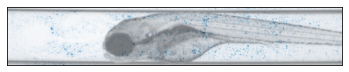

(3, 130, 750)


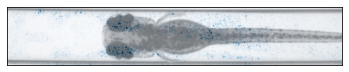

(3, 130, 750)


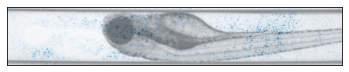

(3, 130, 750)


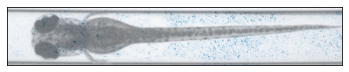

(3, 130, 750)


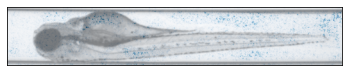

(3, 130, 750)


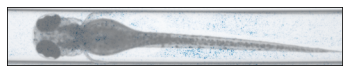

(3, 130, 750)


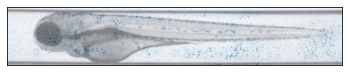

(3, 130, 750)


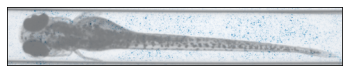

(3, 130, 750)


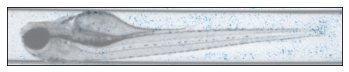

(3, 130, 750)


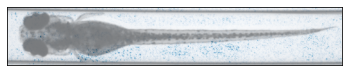

(3, 130, 750)


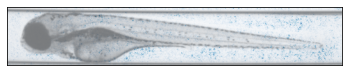

(3, 130, 750)


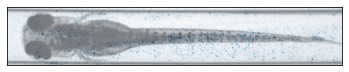

(3, 130, 750)


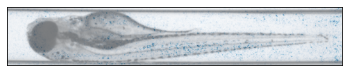

(3, 130, 750)


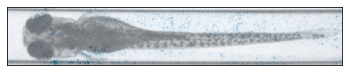

(3, 130, 750)


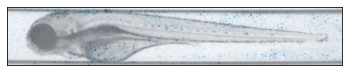

(3, 130, 750)


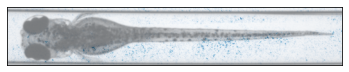

(3, 130, 750)


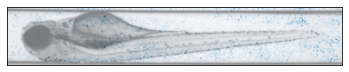

(3, 130, 750)


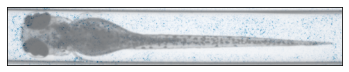

(3, 130, 750)


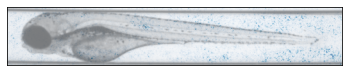

(3, 130, 750)


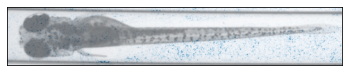

(3, 130, 750)


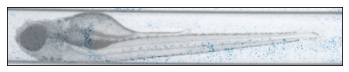

(3, 130, 750)


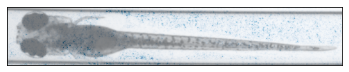

(3, 130, 750)


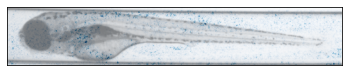

(3, 130, 750)


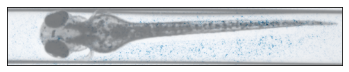

(3, 130, 750)


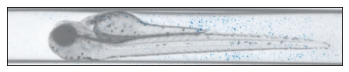

(3, 130, 750)


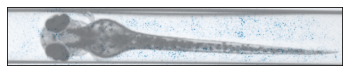

(3, 130, 750)


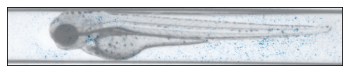

(3, 130, 750)


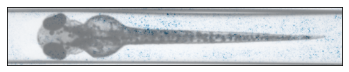

(3, 130, 750)


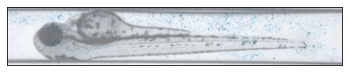

(3, 130, 750)


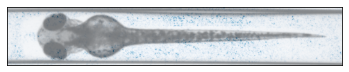

(3, 130, 750)


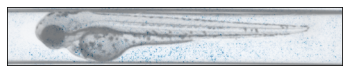

(3, 130, 750)


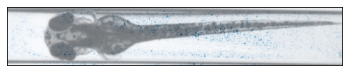

(3, 130, 750)


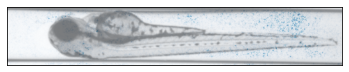

(3, 130, 750)


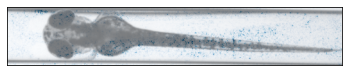

(3, 130, 750)


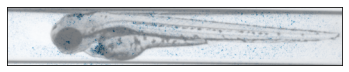

(3, 130, 750)


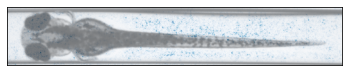

(3, 130, 750)


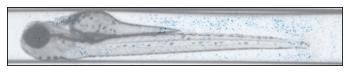

(3, 130, 750)


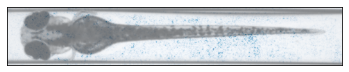

(3, 130, 750)


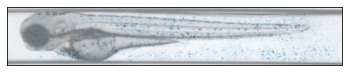

(3, 130, 750)


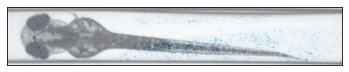

(3, 130, 750)


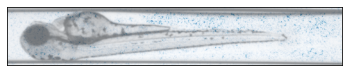

(3, 130, 750)


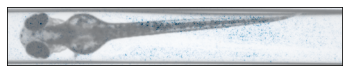

(3, 130, 750)


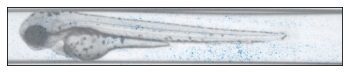

(3, 130, 750)


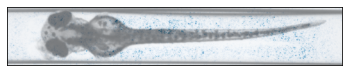

(3, 130, 750)


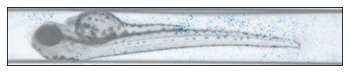

(3, 130, 750)


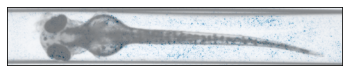

(3, 130, 750)


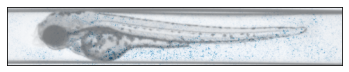

(3, 130, 750)


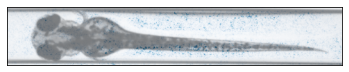

(3, 130, 750)


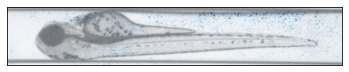

(3, 130, 750)


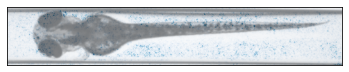

(3, 130, 750)


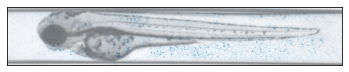

(3, 130, 750)


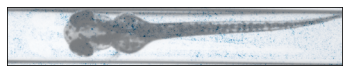

(3, 130, 750)


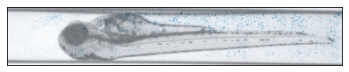

(3, 130, 750)


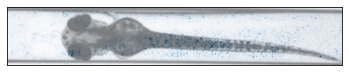

(3, 130, 750)


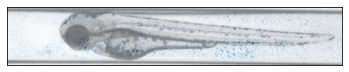

(3, 130, 750)


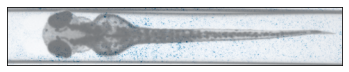

(3, 130, 750)


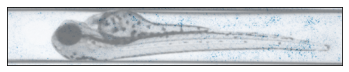

(3, 130, 750)


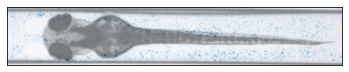

(3, 130, 750)


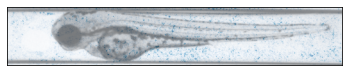

(3, 130, 750)


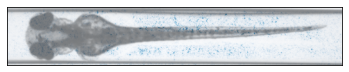

(3, 130, 750)


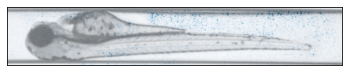

(3, 130, 750)


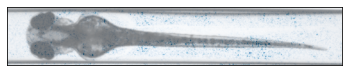

(3, 130, 750)


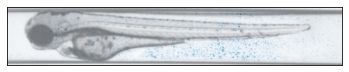

(3, 130, 750)


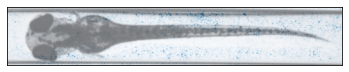

(3, 130, 750)


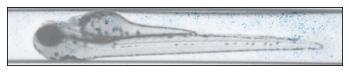

(3, 130, 750)


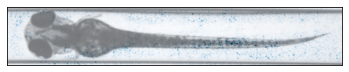

(3, 130, 750)


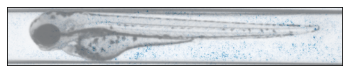

(3, 130, 750)


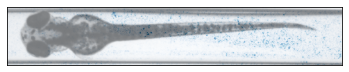

(3, 130, 750)


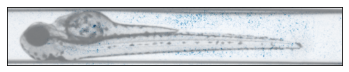

(3, 130, 750)


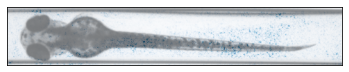

(3, 130, 750)


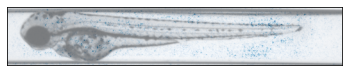

(3, 130, 750)


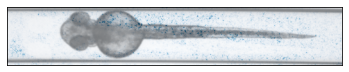

(3, 130, 750)


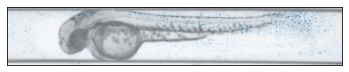

(3, 130, 750)


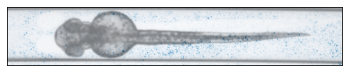

(3, 130, 750)


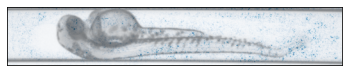

(3, 130, 750)


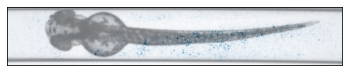

(3, 130, 750)


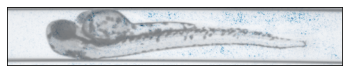

(3, 130, 750)


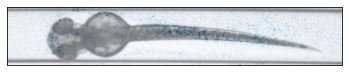

(3, 130, 750)


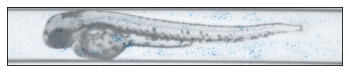

(3, 130, 750)


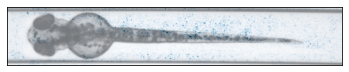

(3, 130, 750)


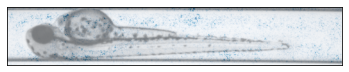

(3, 130, 750)


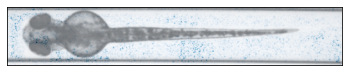

(3, 130, 750)


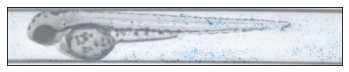

(3, 130, 750)


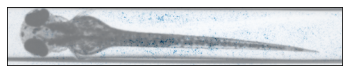

(3, 130, 750)


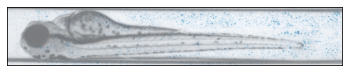

(3, 130, 750)


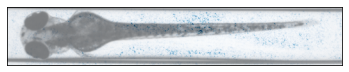

(3, 130, 750)


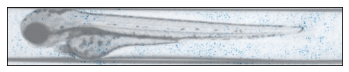

(3, 130, 750)


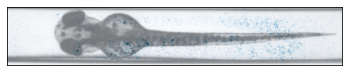

(3, 130, 750)


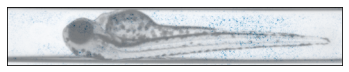

(3, 130, 750)


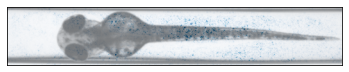

(3, 130, 750)


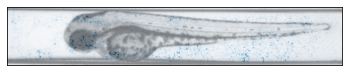

(3, 130, 750)


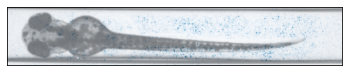

(3, 130, 750)


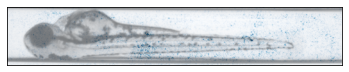

(3, 130, 750)


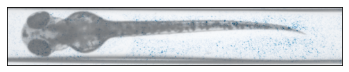

(3, 130, 750)


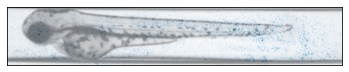

(3, 130, 750)


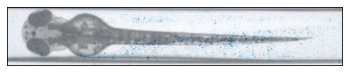

(3, 130, 750)


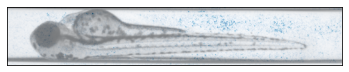

(3, 130, 750)


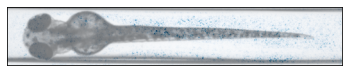

(3, 130, 750)


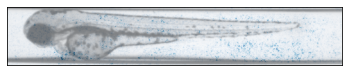

(3, 130, 750)


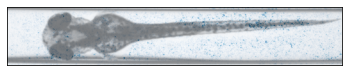

(3, 130, 750)


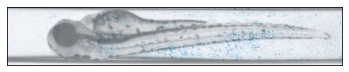

(3, 130, 750)


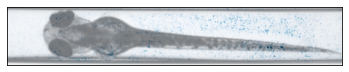

(3, 130, 750)


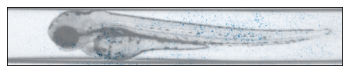

(3, 130, 750)


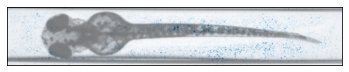

(3, 130, 750)


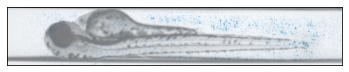

(3, 130, 750)


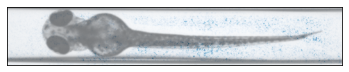

(3, 130, 750)


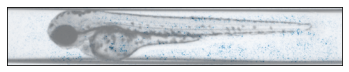

(3, 130, 750)


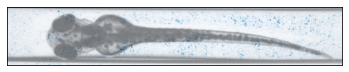

(3, 130, 750)


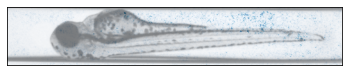

(3, 130, 750)


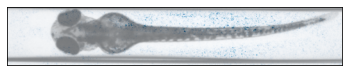

(3, 130, 750)


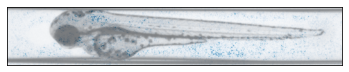

(3, 130, 750)


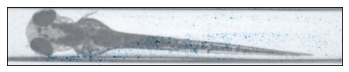

(3, 130, 750)


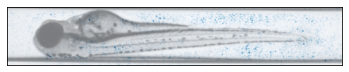

(3, 130, 750)


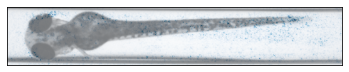

(3, 130, 750)


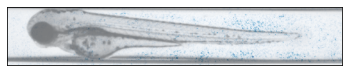

(3, 130, 750)


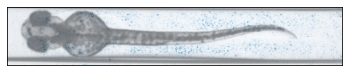

(3, 130, 750)


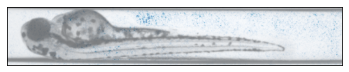

(3, 130, 750)


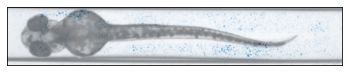

(3, 130, 750)


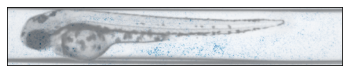

(3, 130, 750)


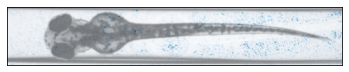

(3, 130, 750)


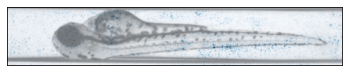

(3, 130, 750)


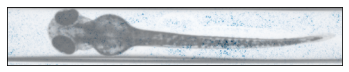

(3, 130, 750)


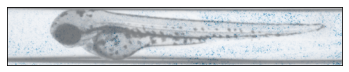

(3, 130, 750)


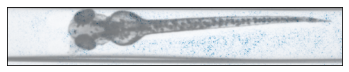

(3, 130, 750)


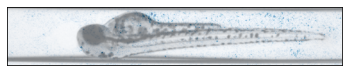

(3, 130, 750)


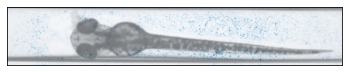

(3, 130, 750)


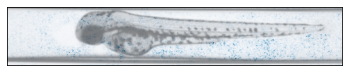

(3, 130, 750)


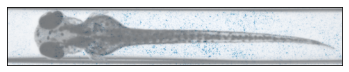

(3, 130, 750)


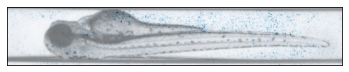

(3, 130, 750)


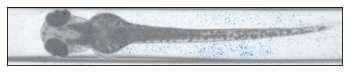

(3, 130, 750)


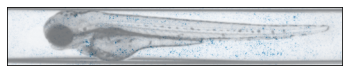

(3, 130, 750)


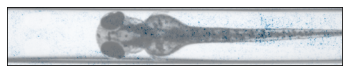

(3, 130, 750)


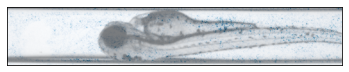

(3, 130, 750)


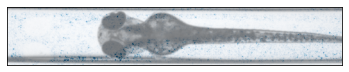

(3, 130, 750)


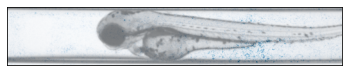

(3, 130, 750)


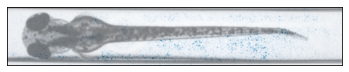

(3, 130, 750)


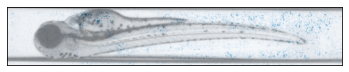

(3, 130, 750)


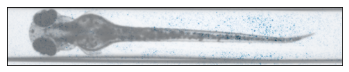

(3, 130, 750)


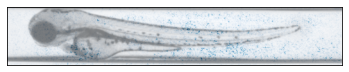

(3, 130, 750)


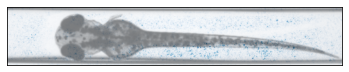

(3, 130, 750)


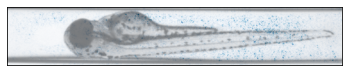

(3, 130, 750)


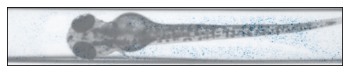

(3, 130, 750)


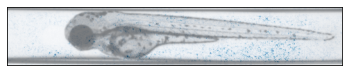

(3, 130, 750)


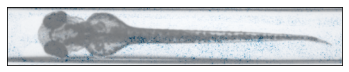

(3, 130, 750)


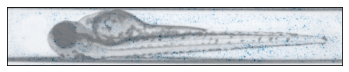

(3, 130, 750)


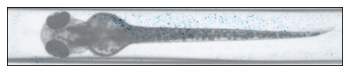

(3, 130, 750)


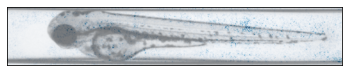

(3, 130, 750)


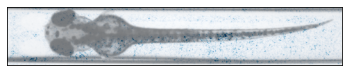

(3, 130, 750)


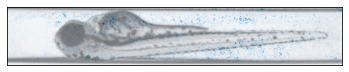

(3, 130, 750)


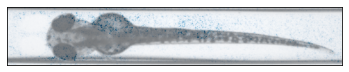

(3, 130, 750)


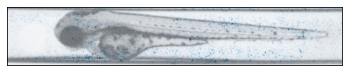

(3, 130, 750)


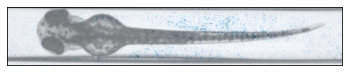

(3, 130, 750)


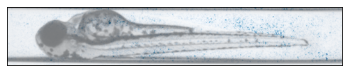

(3, 130, 750)


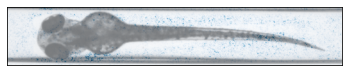

(3, 130, 750)


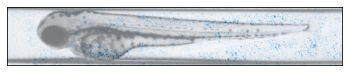

(3, 130, 750)


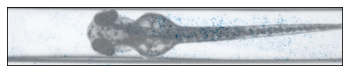

(3, 130, 750)


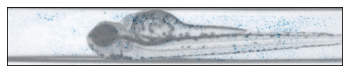

(3, 130, 750)


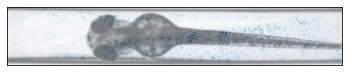

(3, 130, 750)


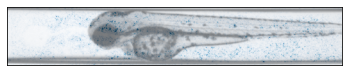

(3, 130, 750)


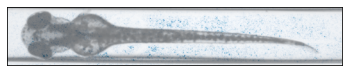

(3, 130, 750)


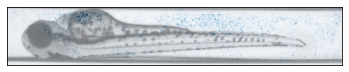

(3, 130, 750)


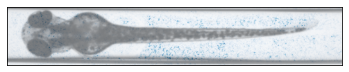

(3, 130, 750)


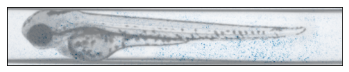

(3, 130, 750)


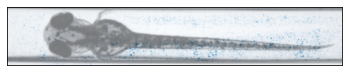

(3, 130, 750)


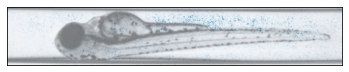

(3, 130, 750)


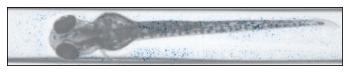

(3, 130, 750)


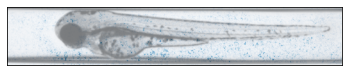

(3, 130, 750)


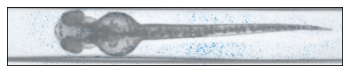

(3, 130, 750)


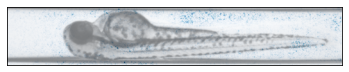

(3, 130, 750)


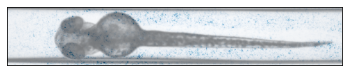

(3, 130, 750)


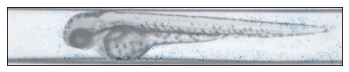

(3, 130, 750)


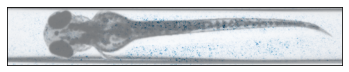

(3, 130, 750)


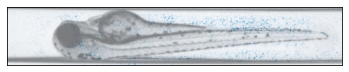

(3, 130, 750)


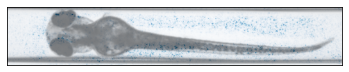

(3, 130, 750)


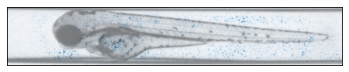

(3, 130, 750)


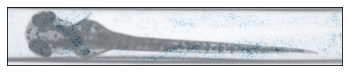

(3, 130, 750)


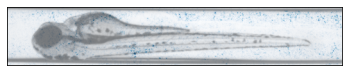

(3, 130, 750)


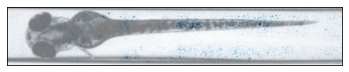

(3, 130, 750)


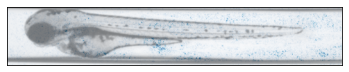

(3, 130, 750)


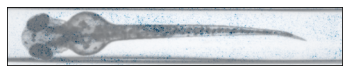

(3, 130, 750)


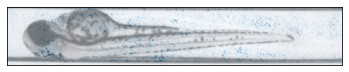

(3, 130, 750)


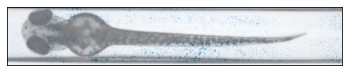

(3, 130, 750)


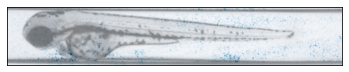

(3, 130, 750)


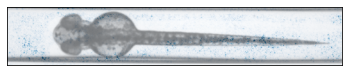

(3, 130, 750)


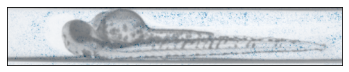

(3, 130, 750)


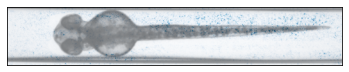

(3, 130, 750)


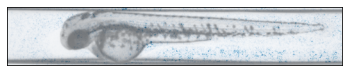

(3, 130, 750)


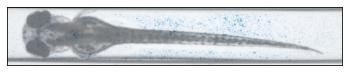

(3, 130, 750)


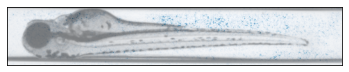

(3, 130, 750)


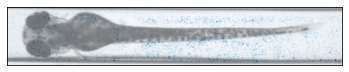

(3, 130, 750)


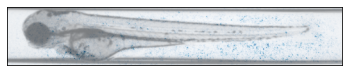

(3, 130, 750)


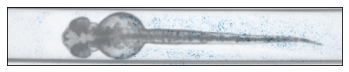

(3, 130, 750)


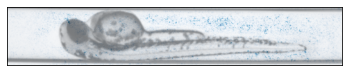

(3, 130, 750)


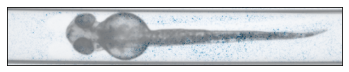

(3, 130, 750)


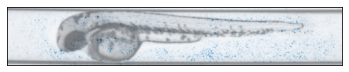

(3, 130, 750)


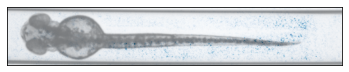

(3, 130, 750)


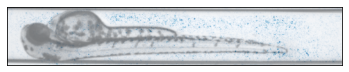

(3, 130, 750)


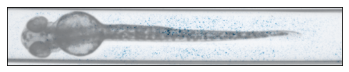

(3, 130, 750)


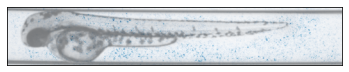

(3, 130, 750)


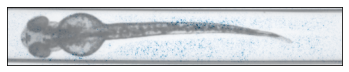

(3, 130, 750)


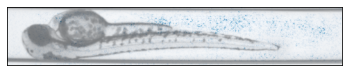

(3, 130, 750)


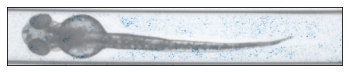

(3, 130, 750)


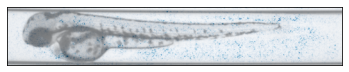

(3, 130, 750)


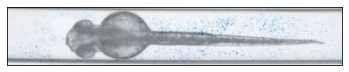

(3, 130, 750)


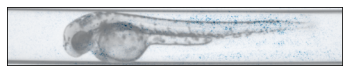

(3, 130, 750)


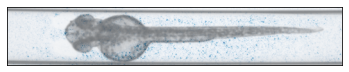

(3, 130, 750)


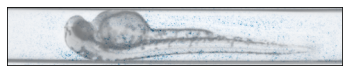

(3, 130, 750)


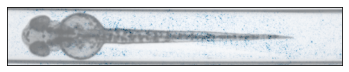

(3, 130, 750)


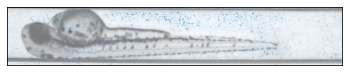

(3, 130, 750)


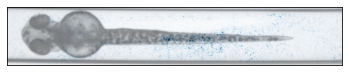

(3, 130, 750)


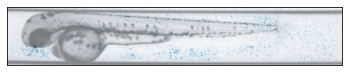

(3, 130, 750)


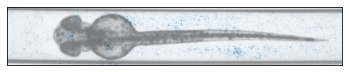

(3, 130, 750)


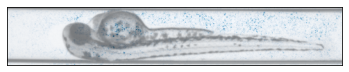

(3, 130, 750)


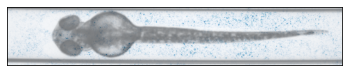

(3, 130, 750)


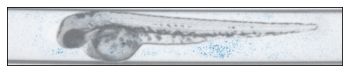

(3, 130, 750)


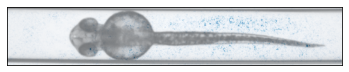

(3, 130, 750)


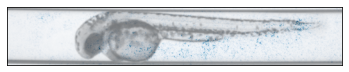

(3, 130, 750)


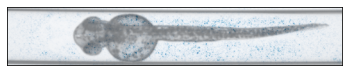

(3, 130, 750)


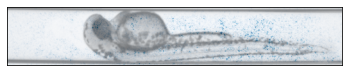

(3, 130, 750)


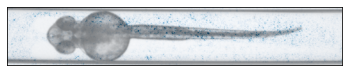

(3, 130, 750)


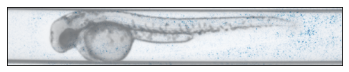

(3, 130, 750)


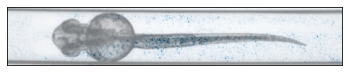

(3, 130, 750)


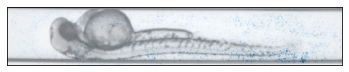

(3, 130, 750)


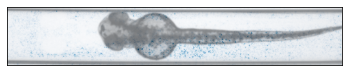

(3, 130, 750)


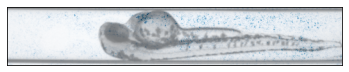

(3, 130, 750)


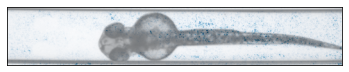

(3, 130, 750)


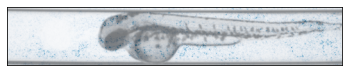

(3, 130, 750)


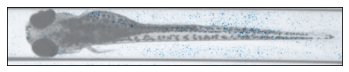

(3, 130, 750)


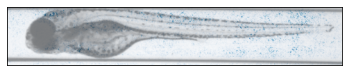

(3, 130, 750)


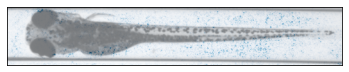

(3, 130, 750)


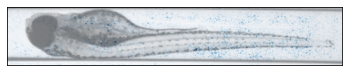

(3, 130, 750)


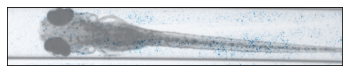

(3, 130, 750)


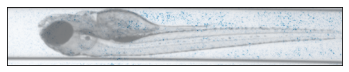

(3, 130, 750)


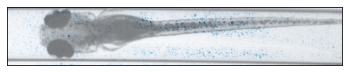

(3, 130, 750)


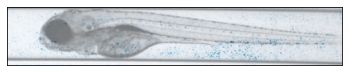

(3, 130, 750)


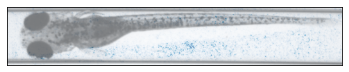

(3, 130, 750)


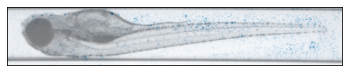

(3, 130, 750)


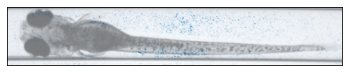

(3, 130, 750)


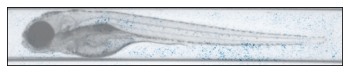

(3, 130, 750)


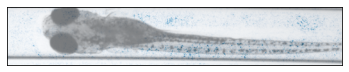

(3, 130, 750)


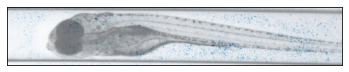

(3, 130, 750)


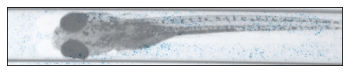

(3, 130, 750)


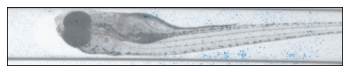

(3, 130, 750)


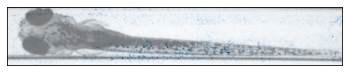

(3, 130, 750)


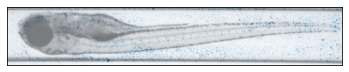

(3, 130, 750)


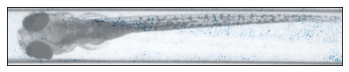

(3, 130, 750)


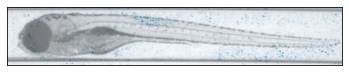

(3, 130, 750)


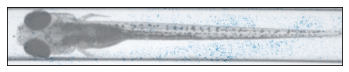

(3, 130, 750)


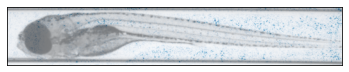

(3, 130, 750)


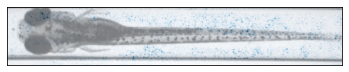

(3, 130, 750)


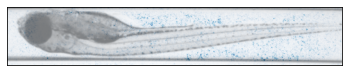

(3, 130, 750)


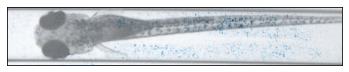

(3, 130, 750)


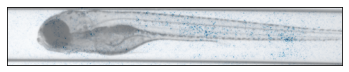

(3, 130, 750)


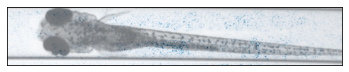

(3, 130, 750)


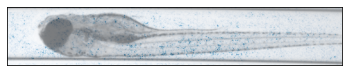

(3, 130, 750)


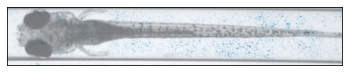

(3, 130, 750)


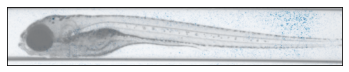

(3, 130, 750)


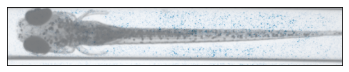

(3, 130, 750)


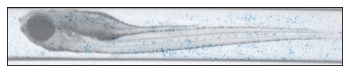

(3, 130, 750)


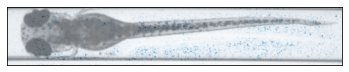

(3, 130, 750)


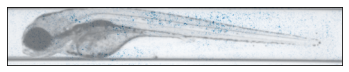

(3, 130, 750)


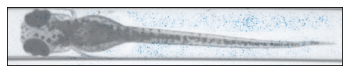

(3, 130, 750)


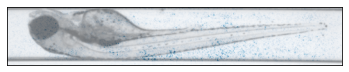

(3, 130, 750)


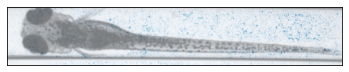

(3, 130, 750)


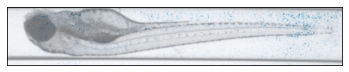

(3, 130, 750)


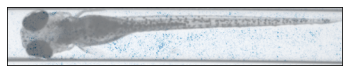

(3, 130, 750)


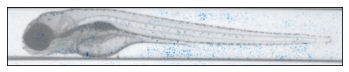

(3, 130, 750)


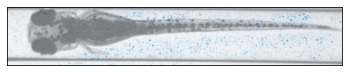

(3, 130, 750)


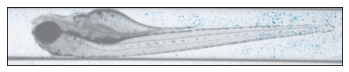

(3, 130, 750)


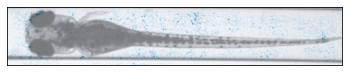

(3, 130, 750)


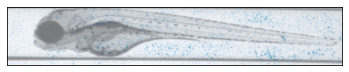

(3, 130, 750)


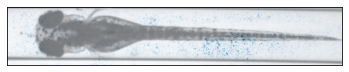

(3, 130, 750)


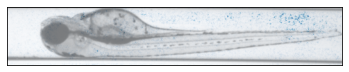

(3, 130, 750)


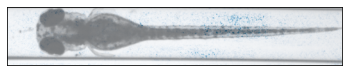

(3, 130, 750)


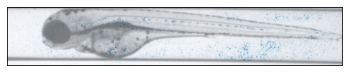

(3, 130, 750)


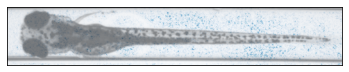

(3, 130, 750)


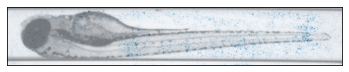

(3, 130, 750)


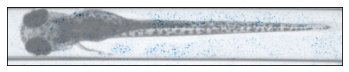

(3, 130, 750)


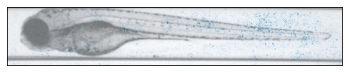

(3, 130, 750)


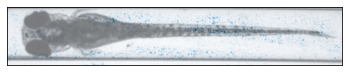

(3, 130, 750)


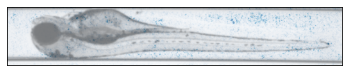

(3, 130, 750)


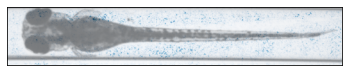

(3, 130, 750)


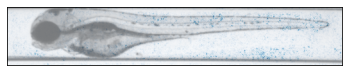

(3, 130, 750)


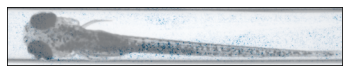

(3, 130, 750)


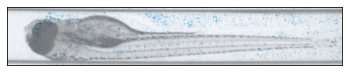

(3, 130, 750)


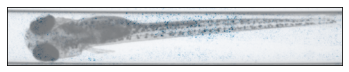

(3, 130, 750)


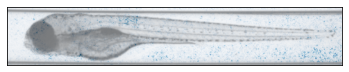

(3, 130, 750)


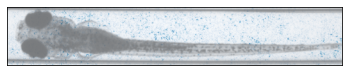

(3, 130, 750)


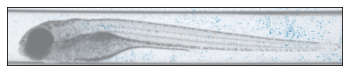

(3, 130, 750)


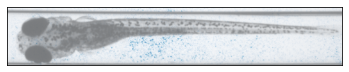

(3, 130, 750)


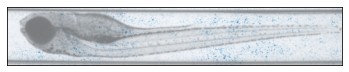

(3, 130, 750)


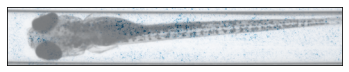

(3, 130, 750)


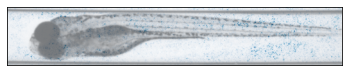

(3, 130, 750)


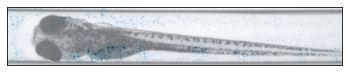

(3, 130, 750)


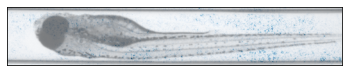

(3, 130, 750)


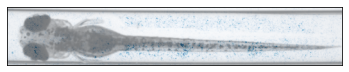

(3, 130, 750)


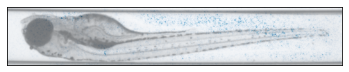

(3, 130, 750)


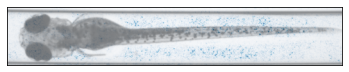

(3, 130, 750)


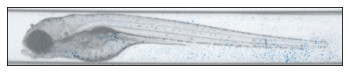

(3, 130, 750)


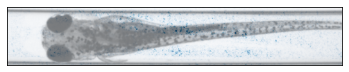

(3, 130, 750)


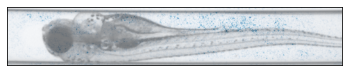

(3, 130, 750)


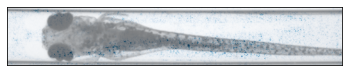

(3, 130, 750)


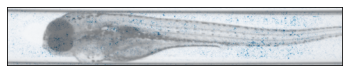

(3, 130, 750)


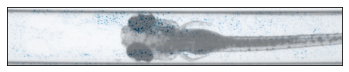

(3, 130, 750)


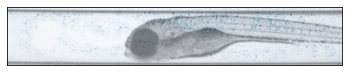

(3, 130, 750)


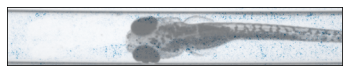

(3, 130, 750)


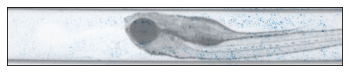

(3, 130, 750)


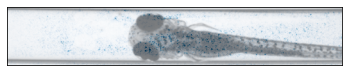

(3, 130, 750)


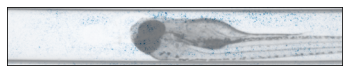

(3, 130, 750)


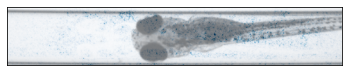

(3, 130, 750)


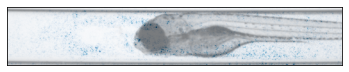

(3, 130, 750)


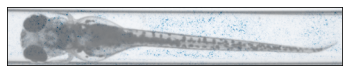

(3, 130, 750)


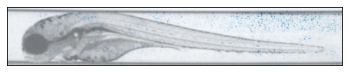

(3, 130, 750)


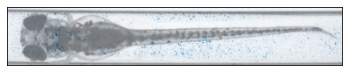

(3, 130, 750)


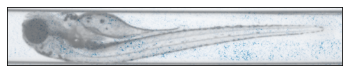

(3, 130, 750)


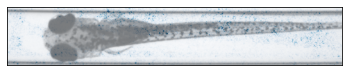

(3, 130, 750)


In [ ]:
# The multiplier on the attribution_data is NOT meant to be permanent, and is an attempt to try to make the individual attributions clearer
# Also, there's no way to silence captum when it generates all the images
fig = umapPlot(embeddingFish, tensor_x.numpy(), tensor_y.squeeze().numpy(), attribution_data.numpy() * 2, title='UMAP projection of the Zebrafish dataset with Integrated Gradients Applied')


In [ ]:
## If you try to generate the plot on Google Colab it dies.
## This entire notebook may need to be run locally, 
## in which case you'll have to download the
## attribution data AND the fish data on your machine and run through 
## the whole process

from bokeh.plotting import output_file

output_file("drive/MyDrive/Fish Attribution/interactive_integrated_gradients.html")

In [ ]:
save(fig)

'' was not found in history, as a file, url, nor in the user namespace.


In [ ]:
# If you're running locally you might need to run the following:
from bokeh.plotting import output_file
output_file(filename="index.html", title="Some Title")
# When you open the index.html file in your browser, you'll get your plot!